In [1]:
from PIL import Image
import os
import random
import cv2
import numpy as np
from matplotlib import pyplot as plt
from tqdm import tqdm
import glob

# tensorflow
import tensorflow as tf
from tensorflow.keras.models import Model

# tensorflow layers
from tensorflow.keras import layers, Model
# VGG19
from tensorflow.keras.applications.vgg19 import VGG19

import tensorflow_addons as tfa

c:\Users\USER\anaconda3\envs\NIPA\lib\site-packages\tensorflow_addons\utils\tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
c:\Users\USER\anaconda3\envs\NIPA\lib\site-packages\tensorflow_addons\utils\ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.11.0 and strictly below 2.14.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.10.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you wa

## GIF to Sequential Dataset(Frame by Frame)

In [2]:
def extract_frames_from_gif(gif_path, output_dir, target_frames=10):
    """
    GIF 파일에서 각 Frame을 추출하여 지정된 폴더에 저장하는 함수
    모든 GIF 파일을 동일한 프레임 수로 맞추기 위해 Interpolate을 사용 (?)
    """
    
    gif = Image.open(gif_path)
    total_frames = gif.n_frames # 전체 Frame 수
    print('Total Frames of the GIF : ', total_frames)
    
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
        
    extracted_frames = []
    for frame in range(total_frames):
        gif.seek(frame)
        frame_img = gif.convert('RGBA')
        extracted_frames.append(frame_img)
        
        
    # Frame 수 조정 (Interpolate / Selection)
    if total_frames < target_frames:
        # 프레임이 부족한 경우 -> Random으로 중간 프레임 Duplicate
        while len(extracted_frames) < target_frames:
            random_idx = random.randint(1, total_frames - 2) # Exclude First & Last Frame
            extracted_frames.insert(random_idx, extracted_frames[random_idx])
            
    elif total_frames > target_frames:
        # 프레임이 많은 경우 -> Random Selection
        step = total_frames / target_frames # Frame 간격
        selected_indices = sorted(random.sample(range(1, total_frames  - 1), total_frames - target_frames))        
           
        extracted_frames = [frame for i, frame in enumerate(extracted_frames) if i not in selected_indices]
    
    extracted_frames = extracted_frames[:target_frames]
    
    for idx, frame in enumerate(extracted_frames):
        frame.save(os.path.join(output_dir, f'{idx}.png'), 'PNG')

In [3]:
def convert_gif_to_frames(gif_path, output_dir):
    """
    GIF 파일에서 각 Frame을 추출하여 지정된 폴더에 저장하는 함수
    모든 GIF 파일을 동일한 프레임 수로 맞추기 위해 Interpolate을 사용 (?)
    """
    
    gif = Image.open(gif_path)
    total_frames = gif.n_frames # 전체 Frame 수
    print('Total Frames of the GIF : ', total_frames)
    
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
        
    extracted_frames = []
    for frame in range(total_frames):
        gif.seek(frame)
        frame_img = gif.convert('RGBA')
        extracted_frames.append(frame_img)
    
    for idx, frame in enumerate(extracted_frames):
        frame.save(os.path.join(output_dir, f'{idx}.png'), 'PNG')

In [146]:
gif_path = 'Dataset/Jump/npc_jump_1.gif'
output_dir = 'Frame_Img/Jump/npc_jump_1'
convert_gif_to_frames(gif_path, output_dir)

Total Frames of the GIF :  7


In [4]:
def character_coords(image_path, padding=10):
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray, 100, 200)
    coords = cv2.findNonZero(edges)
    x, y, w, h = cv2.boundingRect(coords)
    
    # x = max(0, x-padding)
    # y = max(0, y-padding)
    # w = min(image.shape[1]-x, w+2*padding)
    # h = min(image.shape[0]-y, h+2*padding)
    
    x1= max(0, x)
    y1= max(0, y)
    x2= min(image.shape[1], x+w)
    y2= min(image.shape[0], y+h)
    
    # cropped = image[y:y+h, x:x+w]
    cropped= image[y1:y2, x1:x2]
    
    if cropped.shape[2] == 4: # If Image is RGBA
        cropped = cv2.cvtColor(cropped, cv2.COLOR_BGRA2BGR)
    
    # return (x, y, w, h), cropped
    return ((x1, y1), (x2, y2)), cropped

def interpolate_positions(pos1, pos2, num_interpolations=1):
    """
    두 위치 좌표 (x, y)를 선형 보간하여 중간 위치를 생성하는 함수.
    """
    # x1, y1, w1, h1 = pos1
    # x2, y2, w2, h2 = pos2
    (x1_start, y1_start), (x2_start, y2_start) = pos1
    (x1_end, y1_end), (x2_end, y2_end) = pos2
    
    interpolated_positions = []
    for i in range(1, num_interpolations + 1):
        alpha = i / (num_interpolations + 1)
        
        # x = int((1 - alpha) * x1 + alpha * x2)
        # y = int((1 - alpha) * y1 + alpha * y2)
        # w = int((1 - alpha) * w1 + alpha * w2)
        # h = int((1 - alpha) * h1 + alpha * h2)
        # interpolated_positions.append((x, y, w, h))
        
        x1 = int((1 - alpha) * x1_start + alpha * x1_end)
        y1 = int((1 - alpha) * y1_start + alpha * y1_end)
        x2 = int((1 - alpha) * x2_start + alpha * x2_end)
        y2 = int((1 - alpha) * y2_start + alpha * y2_end)
        interpolated_positions.append(((x1, y1), (x2, y2)))
    
    return interpolated_positions

# Linear Interpolation of Frames

def interpolate_frames(frame1_path, frame2_path, num_interpolations=1):
    """
    Apply Linear Interpolation between two Frames.
    To smooth the transition between two frames(motion of the character)
    
    Input:
    num_interpolations: Number of Interpolations between two frames
    
    ** 아직 저장하는 부분 구현 X
    
    Limits:
    1. 배경이 흰색이라고 가정
    2. Object Detection이 완벽하다는 가정
    3. 두 프레임의 캐릭터 크기가 동일하다는 가정이 빠져있음(현재는 첫번째 사진을 기준으로 사용)
    """
    
    # Original Images
    base_image = cv2.imread(frame1_path)
    end_image = cv2.imread(frame2_path)
    
    # Extract Character Coordinates
    pos1, cropped1 = character_coords(frame1_path)
    pos2, cropped2 = character_coords(frame2_path)
    
    # Interpolate Character Positions
    interpolated_positions = interpolate_positions(pos1, pos2, num_interpolations)

    frames = []
    
    base_image_copy = base_image.copy()
    # cv2.rectangle(base_image_copy, pos1[0], pos1[1], (0, 255, 0), 2)
    frames.append(base_image_copy)
    
    for (x1, y1), (x2, y2) in interpolated_positions:

        interpolated_frame = base_image.copy()
        
        (orig_x1, orig_y1), (orig_x2, orig_y2) = pos1
        cv2.rectangle(interpolated_frame, (orig_x1, orig_y1), (orig_x2, orig_y2), (255, 255, 255), -1)
        
        resized_character = cv2.resize(cropped1, (x2 - x1, y2 - y1))
        interpolated_frame[y1:y2, x1:x2] = resized_character
    
        # cv2.rectangle(interpolated_frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        frames.append(interpolated_frame)
    
    # 마지막 end_image에도 bounding box 추가
    (x1_end, y1_end), (x2_end, y2_end) = pos2
    # cv2.rectangle(end_image, (x1_end, y1_end), (x2_end, y2_end), (0, 255, 0), 2)
    frames.append(end_image)
    
    # 시각화
    plt.figure(figsize=(15, 5))
    for idx, frame in enumerate(frames):
        plt.subplot(1, len(frames), idx + 1)
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f'Frame {idx}')
    plt.show()

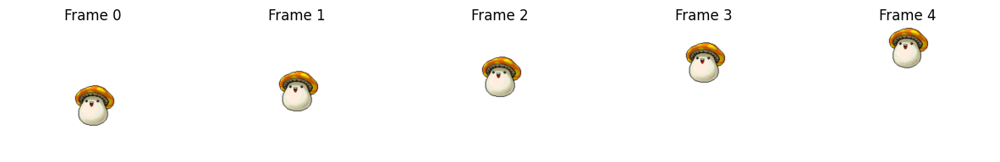

In [110]:
frame1_path = 'C:/Users/USER/Documents/Projects/Google_ML_BootCamp/NIPA/Frame_Img/Jump/npc_jump_1/5.png'
frame2_path = 'C:/Users/USER/Documents/Projects/Google_ML_BootCamp/NIPA/Frame_Img/Jump/npc_jump_1/6.png'
interpolate_frames(frame1_path, frame2_path, num_interpolations=3)

In [3]:
# extract_frames_from_gif('Dataset/Jump/npc_jump_1.gif', 'Frame_Img/Jump/npc_jump_1', 10)

In [4]:
# extract_frames_from_gif('Dataset/Jump/npc_jump_2.gif', 'Frame_Img/Jump/npc_jump_2', 10)

## Crop Charater From Image

In [5]:
def crop_to_character(image_path, padding=10):
    """
    이미지에서 캐릭터가 꽉 차도록 Crop하는 함수
    
    """
    
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # _, mask = cv2.threshold(gray, 170, 255, cv2.THRESH_BINARY)
    
    # coords = cv2.findNonZero(gray)
    # x, y, w, h = cv2.boundingRect(coords)
    edges = cv2.Canny(gray, 100, 200)  # Canny Edge Detection
    coords = cv2.findNonZero(edges)
    x, y, w, h = cv2.boundingRect(coords)
    
    # Bounding Box 주변에 padding 추가    
    x = max(0, x - padding)
    y = max(0, y - padding)
    w = min(image.shape[1] -  x, w + 2 * padding)
    h = min(image.shape[0] - y, h + 2 * padding)
    
    image_with_bbox = image.copy()
    cv2.rectangle(image_with_bbox, (x, y), (x+w, y+h), (0,255,0), 2)
    
    # Crop the image
    cropped = image[y:y+h, x:x+w]
    
    # Visualize
    plt.figure(figsize=(10, 10))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image_with_bbox, cv2.COLOR_BGR2RGB))
    plt.title("Original Image")
    plt.axis("off")
    
    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
    plt.title("Cropped Image")
    plt.axis("off")
    
    plt.show()
    
    
    return cropped

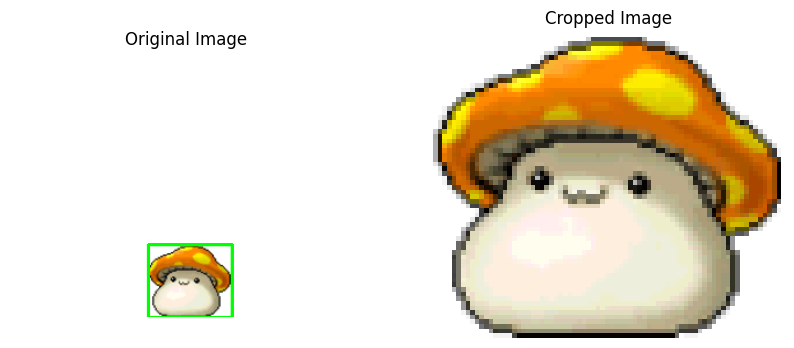

In [60]:
# crop_to_character('Frame_Img/Jump/npc_jump_1/0.png', 0)

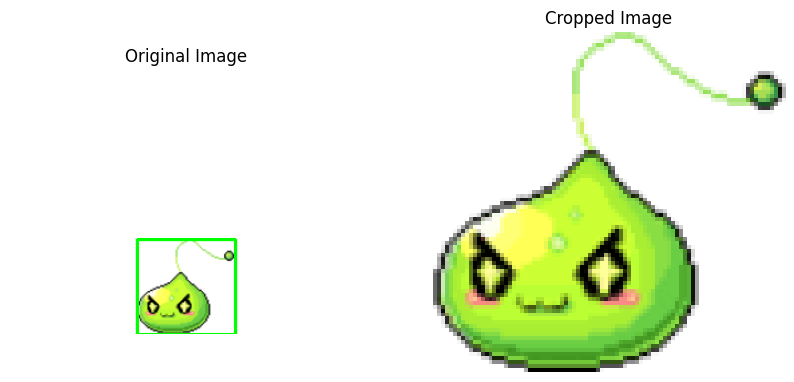

In [63]:
# crop_to_character('Frame_Img/Jump/npc_jump_2/0.png', 0)

## Data Preparation

In [6]:
def process_gif_to_dataset(gif_path, dataset_dir, target_frames=10, padding=10):
    """
    GAN + LSTM 모델 학습을 위한 데이터셋 준비 함수 
    
    Input : GIF Images (Sequence of Frames)
    Output : Character Image & Frame Images of Motion
    """
    
    frames_dir = os.path.join(dataset_dir)
    extract_frames_from_gif(gif_path, frames_dir, target_frames)
    
    cropped_frames_dir = os.path.join(dataset_dir)
    
    frame_path  = os.path.join(frames_dir, f'0.png')
    cropped_image = crop_to_character(frame_path, padding)
    
    input_image_path = os.path.join(cropped_frames_dir, f'{dataset_dir.split("/")[-1]}_Input.png')
    cv2.imwrite(input_image_path, cropped_image)
    
    print(f"Processed {gif_path} -> {cropped_frames_dir}")

Total Frames of the GIF :  7


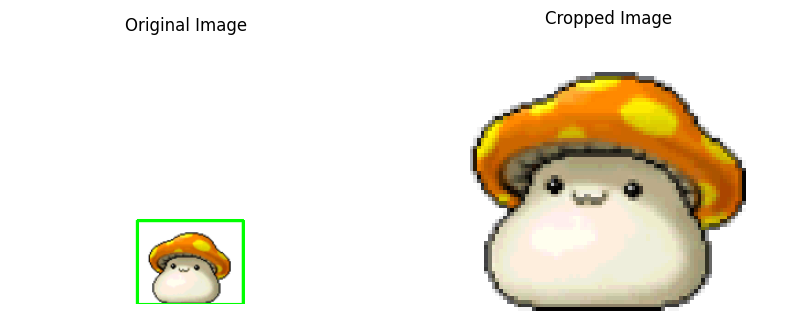

Processed Dataset/Jump/npc_jump_1.gif -> Frame_Img/Jump/npc_jump_1


In [7]:
gif_path = 'Dataset/Jump/npc_jump_1.gif'
dataset_dir = 'Frame_Img/Jump/npc_jump_1'
process_gif_to_dataset(gif_path, dataset_dir, target_frames=7, padding=10)

## Run Data Load

In [2]:
def label_to_one_hot(labels, num_classes, repeat):
  now_label_dataset = np.zeros((num_classes))
  now_label_dataset[labels]  = 1
  now_label_dataset = np.expand_dims(now_label_dataset, axis=0)
  now_label_dataset = np.repeat(now_label_dataset, repeats=repeat, axis=0)
  return now_label_dataset

def load_multiple_npy_files(directory_path):
    # directory_path에 있는 모든 .npy 파일 경로 가져오기
    file_paths = glob.glob(f"{directory_path}/*.npy")
    
    # 각 npy 파일을 로드하여 리스트에 추가
    datasets = [np.load(file) for file in file_paths]
    
    # 모든 npy 파일을 하나의 배열로 결합 (첫 번째 축을 기준으로)
    combined_dataset = np.concatenate(datasets, axis=0)
    
    return combined_dataset
  
def visualize_rgba_dataset(dataset, batch_index=0, num_frames=10):
    # num_frames 개수만큼 샘플의 프레임을 시각화
    plt.figure(figsize=(12, 6))
    for i in range(num_frames):
        plt.subplot(1, num_frames, i + 1)
        
        # (높이, 넓이, RGBA) 형식으로 프레임을 시각화
        plt.imshow(dataset[batch_index, i])  # 배치와 프레임 선택
        plt.axis('off')
    plt.show()

In [3]:
combined_dataset = load_multiple_npy_files('Frame_Img/Walk/')   
combined_dataset.shape

(305, 10, 128, 128, 4)

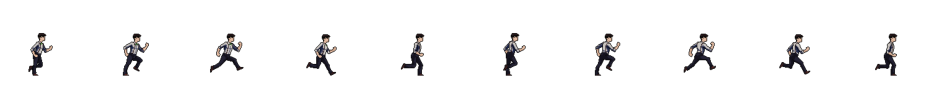

In [4]:
visualize_rgba_dataset(combined_dataset, batch_index=185, num_frames=10)

## GAN + LSTM
- Image -> Motion GIF (ex. Jump, Walk... etc)
- GAN은 Frame Generate + LSTM은 Sequence를 담당

#### **데이터셋 예시**

| **Input (Character Image)** | **Output (Frame Sequence - JUMP GIF)** |
|-----------------------------|----------------------------------------|
| `character_1.png`           | `jump_1/frame_1.png, jump_1/frame_2.png, ..., jump_1/frame_10.png` |
| `character_2.png`           | `jump_2/frame_1.png, jump_2/frame_2.png, ..., jump_2/frame_10.png` |
| `character_3.png`           | `jump_3/frame_1.png, jump_3/frame_2.png, ..., jump_3/frame_10.png` |
| `character_4.png`           | `jump_4/frame_1.png, jump_4/frame_2.png, ..., jump_4/frame_10.png` |
| `character_5.png`           | `jump_5/frame_1.png, jump_5/frame_2.png, ..., jump_5/frame_10.png` |

#### **설명**
- **Input (Character Image)**: 각 캐릭터의 정적 이미지 파일 이름입니다. 모델의 **입력**으로 사용됩니다.
- **Output (Frame Sequence - JUMP GIF)**: JUMP 동작을 표현하는 **10개의 연속된 프레임 이미지**입니다. 
  - 예를 들어, `jump_1` 폴더에는 `frame_1.png`부터 `frame_10.png`까지가 포함되어 있으며, 이는 `character_1.png`와 매칭됩니다.
  - 모든 출력 시퀀스는 동일한 길이의 프레임을 가지며, 이를 통해 모델이 정해진 시퀀스를 학습할 수 있게 됩니다.


Generator
- 독립적으로 입력된 캐릭터와 비슷한 이미지를 생성할 수 있는지 Test

**참고자료**
- https://velog.io/@hayaseleu/Transposed-Convolutional-Layer%EC%9D%80-%EB%AC%B4%EC%97%87%EC%9D%B8%EA%B0%80

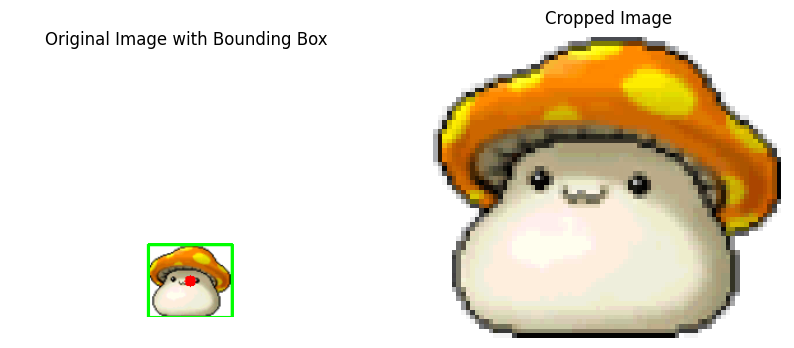

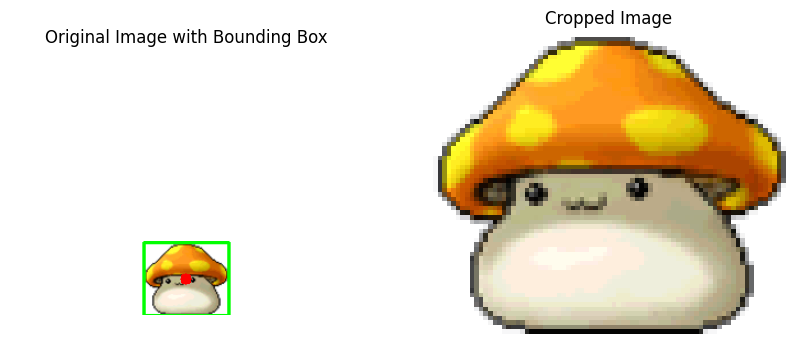

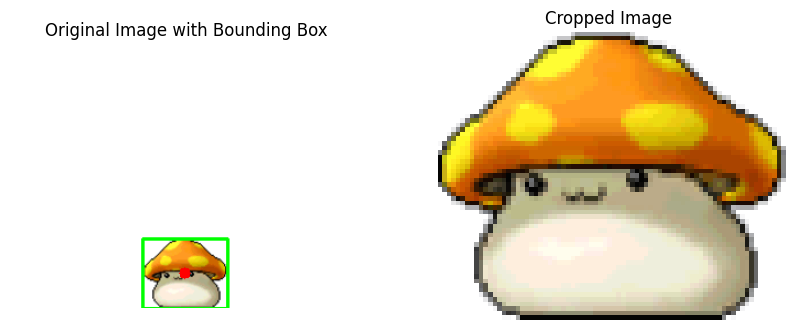

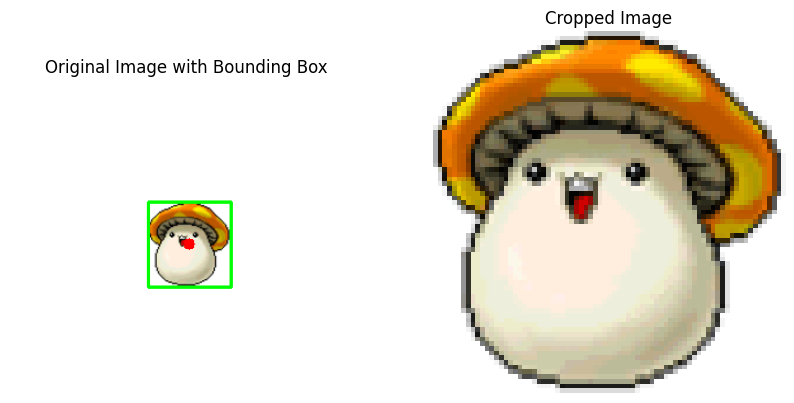

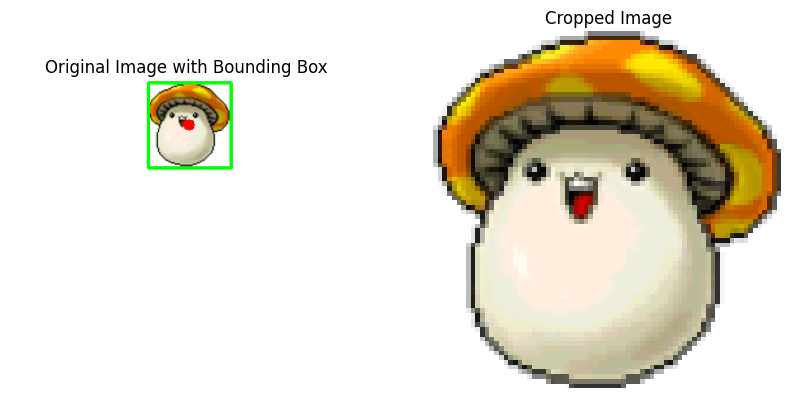

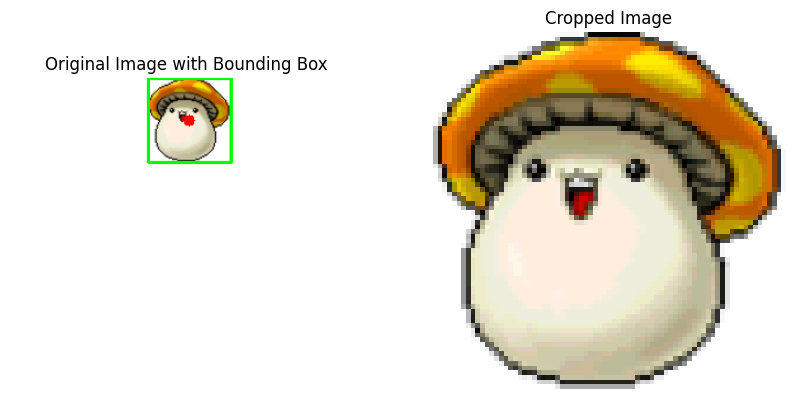

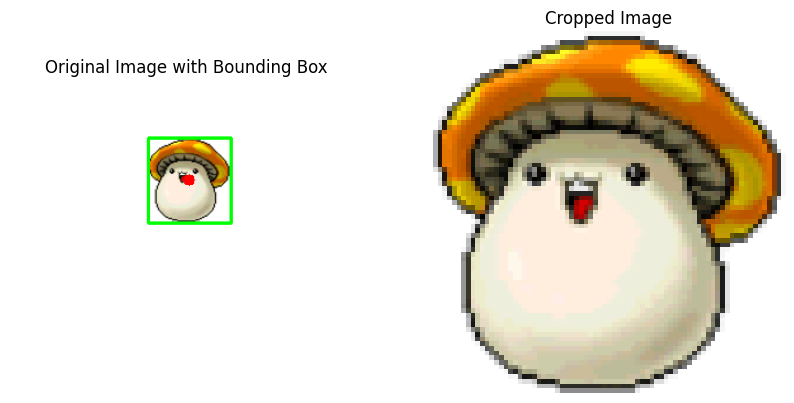

In [5]:
def coords_finder(image_path,padding=0):
    """
    이미지에서 캐릭터가 꽉 차도록 Crop하고, 좌표를 반환하는 함수
    좌표를 {frame_number}_position.txt 파일로 저장
    """
    
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray, 100, 200)
    coords = cv2.findNonZero(edges)
    x, y, w, h = cv2.boundingRect(coords)
    
    x = max(0, x - padding)
    y = max(0, y - padding)
    w = min(image.shape[1] -  x, w + 2 * padding)
    h = min(image.shape[0] - y, h + 2 * padding)
    
    center_x = x + w // 2
    center_y = y + h // 2

    frame_number = os.path.splitext(os.path.basename(image_path))[0] 
    position_path = os.path.join(os.path.dirname(image_path), f"{frame_number}_position.txt")
    # with open(position_path, "w") as f:
    #     f.write(f"{center_x},{center_y}")
    
    # 이미지 Crop
    cropped = image[y:y+h, x:x+w]
    
    cropped_image_path = os.path.join(f"C:/Users/USER/Documents/Projects/Google_ML_BootCamp/NIPA/Frame_Img/Jump/Sample/{frame_number}_cropped.png")
    cv2.imwrite(cropped_image_path, cropped)
    
        
    # 시각화
    image_with_bbox = image.copy()
    cv2.rectangle(image_with_bbox, (x, y), (x + w, y + h), (0, 255, 0), 2)
    cv2.circle(image_with_bbox, (center_x, center_y), 5, (0, 0, 255), -1)
    
    plt.figure(figsize=(10, 10))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image_with_bbox, cv2.COLOR_BGR2RGB))
    plt.title("Original Image with Bounding Box")
    plt.axis("off")
    
    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
    plt.title("Cropped Image")
    plt.axis("off")
    
    plt.show()
    
    return cropped
    

# Frame 경로 예시
dataset_dir = "Frame_Img/Jump/npc_jump_1"
for i in range(7):
    image_path = os.path.join(dataset_dir, f"{i}.png")
    if os.path.exists(image_path):
        coords_finder(image_path)
    else:
        print(f"Image {image_path} not found.")

In [56]:
class Ayo_Generator(Model):
    """
    Generator Model for GAN
    "이미지를 GIF로 생성하는 모델"
    : Mixture of CNN, Attention Layer, LSTM for Frame Generation
    
    Input:
    - sequence_length: Number of Frames to Generate
    
    Output:
    - Generated Frames (Motion of Train GIF)
    """
    def __init__(self, sequence_length=10):
        super(Ayo_Generator, self).__init__()
        self.sequence_length = sequence_length

        # UNet Encoder
        """
        Input : Image (batch_size, sequence_length, height, width, channels), (305, 10, 128, 128, 4)
        Output : Image (batch_size, sequence_length, height, width, channels), (305, 8, 8, 512)
        """
        self.encoder_layers = [
            layers.Conv2D(64, kernel_size=3, strides=2, padding='same', activation='relu'), # (128, 128, 4) -> (64, 64, 64)            # Second Conv2D Layer : Learn More Complex Features
            layers.Conv2D(128, kernel_size=3, strides=2, padding='same', activation='relu'), # (64, 64, 64) -> (32, 32, 128)            # Third Conv2D Layer : Learn More Complex Features
            layers.Conv2D(256, kernel_size=3, strides=2, padding='same', activation='relu'), # (32, 32, 128) -> (16, 16, 256)
            layers.Conv2D(512, kernel_size=3, strides=2, padding='same', activation='relu'), # (16, 16, 256) -> (8, 8, 512)
        ]

        # Dense layer (Fully Connected Layer) 
        """
        While Compressing 8*8*512 to 128, leave only important features of the Frame
        
        Input : Output of Encoder (batch_size, 8, 8, 512)
        Output : Output of Encoder (batch_size, 128)
        """
        self.reduce_features = layers.Dense(128, activation='relu')

        # Frame index embedding layer
        self.frame_embedding = layers.Embedding(input_dim=10, output_dim=128)

        # Dense layer to match LSTM output to decoder input shape
        self.expand_layer = layers.Dense(16 * 16 * 128, activation='relu')

        # UNet Decoder with skip connections
        self.decoder_layers = [
            layers.UpSampling2D(size=2),
            layers.Conv2D(256, kernel_size=3, strides=1, padding='same', activation='relu'), # (16, 16, 128) -> (32, 32, 128)
            layers.UpSampling2D(size=2),
            layers.Conv2D(128, kernel_size=3, strides=1, padding='same', activation='relu'), # (32, 32, 64) -> (64, 64, 64)
            layers.UpSampling2D(size=2),
            layers.Conv2D(64, kernel_size=3, strides=1, padding='same', activation='relu'), # (64, 64, 64) -> (128, 128, 4)
            layers.Conv2D(4, kernel_size=3, strides=1, padding='same', activation='tanh')
        ]

        # Layers to match skip connection channels
        self.match_channels_layers = [
            layers.Conv2D(256, kernel_size=1, padding='same'),
            layers.Conv2D(128, kernel_size=1, padding='same'),
            layers.Conv2D(64, kernel_size=1, padding='same')
        ]


    def call(self, input_image, frame_index):
        x = input_image
        skip_connections = []

        # Encoder with skip connections
        for layer in self.encoder_layers:
            x = layer(x)
            skip_connections.append(x)

        # Flatten and reduce to match LSTM input size
        features = tf.keras.layers.Flatten()(x)
        features = self.reduce_features(features)  # (batch_size, 128)

        # Expand frame_index to match the batch size
        frame_index = tf.reshape(frame_index, (-1, 1))  # Reshape to (batch_size, 1)
        frame_embedding = self.frame_embedding(frame_index)  # Get embeddings
        frame_embedding = tf.squeeze(frame_embedding, axis=1)  # Remove extra dimension after embedding

        # Concatenate features with frame embedding
        combined_features = tf.concat([features, frame_embedding], axis=-1)

        # Expand combined features to decoder input shape
        lstm_output_expanded = self.expand_layer(combined_features)
        x = tf.reshape(lstm_output_expanded, (-1, 16, 16, 128))

        # Decoder with skip connections
        for i, layer in enumerate(self.decoder_layers):
            if i < len(skip_connections):
                skip_connection = skip_connections[-(i + 1)]
                if i < len(self.match_channels_layers):
                    skip_connection = self.match_channels_layers[i](skip_connection)
                skip_connection = tf.image.resize(skip_connection, tf.shape(x)[1:3])
                x = tf.concat([x, skip_connection], axis=-1)
            x = layer(x)

        return x  # Return a single frame


class Ayo_Discriminator(Model):
    def __init__(self):
        super(Ayo_Discriminator, self).__init__()
        self.conv = tf.keras.Sequential([
            layers.Conv2D(64, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.BatchNormalization(),
            layers.Conv2D(128, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.BatchNormalization(),
            layers.Conv2D(256, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.BatchNormalization(),
            layers.Flatten(),
            layers.Dense(512, activation='relu'),
            layers.Dense(1, activation='sigmoid')
        ])

    def call(self, input_image, frames):
        # `frames`가 시퀀스인지 개별 프레임인지 확인
        if len(frames.shape) == 5:  # 시퀀스 (batch, sequence_length, height, width, channels)
            batch_size, sequence_length, height, width, channels = frames.shape
            input_resized = tf.image.resize(input_image, [height, width])
            input_resized = tf.expand_dims(input_resized, axis=1)
            input_resized = tf.tile(input_resized, [1, sequence_length, 1, 1, 1])
            
            outputs = []
            for i in range(sequence_length):
                frame = frames[:, i]
                combined = tf.concat([input_resized[:, i], frame], axis=-1)
                combined_resized = tf.image.resize(combined, [64, 64])
                output = self.conv(combined_resized)
                outputs.append(output)
            return tf.reduce_mean(outputs, axis=0)
        
        elif len(frames.shape) == 4:  # 개별 프레임 (batch, height, width, channels)
            batch_size, height, width, channels = frames.shape
            input_resized = tf.image.resize(input_image, [height, width])
            combined = tf.concat([input_resized, frames], axis=-1)
            combined_resized = tf.image.resize(combined, [64, 64])
            return self.conv(combined_resized)

# VGG19 Model 
"""
Perceptual Loss를 계산하기 위해 VGG19 모델의 중간 레이어(block4_conv2) 사용
-> 'Real Image'와 'Generated Image' 간의 고수준 특성 차이를 측정하는 함수

** 결과적으로 Perceptual Loss는 생성된 이미지가 실제 이미지처럼 보이도록 유도

"""
def build_vgg19_perceptual_loss():
    vgg = VGG19(weights="imagenet", include_top=False, input_shape=(128, 128, 3))
    selected_layer = ['block4_conv2']
    outputs = [vgg.get_layer(name).output for name in selected_layer]
    model = Model(inputs=vgg.input, outputs=outputs)
    model.trainable = False
    
    return model

vgg_for_perceptual_loss = build_vgg19_perceptual_loss()    

def perceptual_loss(real_images, generated_images, perceptual_weight=0.1):
    """
    real image와 generated image 사이의 Perceptual Loss 계산
    
    Args:
        - real_images : 실제 이미지 tensor
        - generated_images : 생성된 이미지 tensor
        - perceptual_weight : Perceptual Loss 가중치 
                              -> 최종 Generator Loss에 Perceptual Loss가 얼마나 영향을 미칠지 결정
                              이게 높을 수록 이미지의 고수준 특성을 더 많이 반영
    
    """

    # 시퀀스(여러 프레임)인 경우 (batch_size, sequence_length, height, width, channels)
    if len(real_images.shape) == 5: 
        sequence_length = real_images.shape[1]
        
        perc_loss = 0
        
        for i in range(sequence_length):            
            # VGG19 모델을 통해 feature map 추출
            real_features = vgg_for_perceptual_loss(real_images[:, i, :, :, :3])
            generated_features = vgg_for_perceptual_loss(generated_images[:, i, :, :, :3])
            
            perc_loss += tf.reduce_mean(tf.square(real_features - generated_features))

        # Number of Frames로 평균, Perceptual Loss 가중치 적용
        perc_loss = (perc_loss / sequence_length) * perceptual_weight
        
        return perc_loss

    # 단일 프레임인 경우 (batch_size, height, width, channels)
    elif len(real_images.shape) == 4: 
        # VGG19 모델을 통해 feature map 추출 (RGBA -> RGB)
        real_features = vgg_for_perceptual_loss(real_images[:, :, :, :3])
        generated_features = vgg_for_perceptual_loss(generated_images[:, :, :, :3])
        
        # 단일 프레임에 대한 Perceptual Loss 계산
        perc_loss = tf.reduce_mean(tf.square(real_features - generated_features)) * perceptual_weight
        return perc_loss

# Loss Functions
bce_loss = tf.keras.losses.BinaryCrossentropy(from_logits=False)

import tensorflow.keras.backend as K
# MSE_RGB loss
def mse_rgb(y_true, y_pred):
    # accounting Alpha channel
    return K.mean(K.square(y_true - y_pred), axis=-1)
    
def generator_loss(fake_output, real_images, generated_images):
    """
    Args:
        - fake_output : Generated Image(fake image)에 대한 Discriminator의 출력
        - real_images : 실제 이미지
        - generated_images : 생성된 이미지
        - sim_weight : Frame 유사성 손실 가중치 (???)
        - perceptual_weight : Perceptual Loss 가중치 (???)
        
    Loss Components:
        - Binary Cross Entropy
        - Frame Similarity Loss
        - Temporal Consistency Loss
        - Perceptual Loss
    """
    
    # Binary Cross Entropy Loss 
    # bce = bce_loss(tf.ones_like(fake_output), fake_output)
    
    # Frame Similarity Loss
    # frame_sim_loss = tf.reduce_mean(tf.square(real_images - generated_images)) * sim_weight
    mse_rgb_loss = mse_rgb(real_images, generated_images)

    # Temporal Consistency Loss -> Generated된 Image Sequence에서, 인접한 Frame 간의 차이를 최소화 (Frame간의 Consistency)
    
    # 생각되는 문제 : 각 프레임이 독립적으로 생성되고 있기 때문에, 생성된 프레임 간의 일관성을 요구할 이유 X
    # consistency_loss = tf.reduce_mean(
    #     [tf.square(generated_images[:, i+1] - generated_images[:, i]) for i in range(generated_images.shape[1] - 1)]
    # ) * consistency_weight

    # Perceptual Loss 추가
    # perc_loss = perceptual_loss(real_images, generated_images, perceptual_weight)
    
    # return bce + frame_sim_loss + perc_loss
    # return bce + mse_rgb_loss + perc_loss
    return mse_rgb_loss


def discriminator_loss(real_output, fake_output):
    # Real Image를 'Real'로 판별하도록 하는 손실
    real_loss = bce_loss(tf.ones_like(real_output) * 0.8, real_output)
    
    # Fake Image를 'Fake'로 판별하도록 하는 손실
    fake_loss = bce_loss(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss


# Optimizers
"""
learning_rate : 학습률
beta_1 : Momentum value, Optimizer가 이전 학습 정보를 참고하는 비율
"""
generator_optimizer = tf.keras.optimizers.Adam(learning_rate = 0.0001, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate = 0.00001, beta_1=0.5)


# Generator와 Discriminator Instance를 num_frames만큼 개별 생성
num_frames = 10
generators = [Ayo_Generator(sequence_length=1) for _ in range(num_frames)]
discriminators = [Ayo_Discriminator() for _ in range(num_frames)]


# Training Step
def train_step_per_frame(generators, discriminators, real_images, input_image, batch_size=16):
    """
    GAN의 Generator와 Discriminator를 학습하는 함수
    -> 한 번의 batch를 처리할 때 호출 (step 단위) 
    
    Args:
        - generators : 각 Frame에 대한 개별 Generator 모델 리스트
        - discriminators : 각 Frame에 대한 개별 Discriminator 모델 리스트
        - real_images : 실제 이미지 (Sequence of Frames) -> (batch_size, sequence_length, height, width, channels)
        - input_image : Generator에 입력되는 Initial Image
    
    """
    
    gen_losses = []
    disc_losses = []

    # Frame별 Generator/Discriminator 학습
    for frame_index in range(num_frames):
        if frame_index == 0:
            continue  # 첫 번째 프레임은 입력 이미지와 동일하므로 스킵
        # GradientTape을 통해 Generator와 Discriminator의 Gradient 계산 (Loss)
        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            """
            특정 Frame에 대해 Generator로 이미지 생성
            Args:
                - input_image : Generator에 입력되는 Initial Image (해당 이미지를 기준으로 생성)
                - tf.constant([frame_index] * batch_size) : Frame Index를 batch_size만큼 복제하여 Generator에 입력
                  -> 현재 배치의 모든 샘플에 대해 동일하게 frame_index가 적용되도록
            """
            generated_frame = generators[frame_index](input_image, tf.constant([frame_index] * batch_size))
            
            real_frame = real_images[:, frame_index]
            
            real_output = discriminators[frame_index](input_image, real_frame)
            fake_output = discriminators[frame_index](input_image, generated_frame)

            gen_loss = generator_loss(fake_output, real_frame, generated_frame)
            disc_loss = discriminator_loss(real_output, fake_output)

            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)

        # 프레임별로 Generator와 Discriminator 가중치 업데이트
        gradients_of_generator = gen_tape.gradient(gen_loss, generators[frame_index].trainable_variables)
        gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminators[frame_index].trainable_variables)

        generator_optimizer.apply_gradients(zip(gradients_of_generator, generators[frame_index].trainable_variables))
        discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminators[frame_index].trainable_variables))

    avg_gen_loss = tf.reduce_mean(gen_losses)
    avg_disc_loss = tf.reduce_mean(disc_losses)

    # print(f"Generator Loss: {avg_gen_loss.numpy()}, Discriminator Loss: {avg_disc_loss.numpy()}")
    return avg_gen_loss, avg_disc_loss



def visualize_sample(initial_image, real_frames, generated_frames, epoch, batch_index, sequence_length=10):
    """
    Input 이미지와 생성된 Output 프레임을 시각화하여 확인
    """
    fig, axes = plt.subplots(3, sequence_length, figsize=(sequence_length * 2, 6))
    
    # 첫 번째 행: Input Image 한 장만 표시
    input_img = (initial_image[0].numpy() + 1) / 2  # [-1, 1] 범위를 [0, 1]로 변환
    for i in range(sequence_length):
        if i == 0:
            axes[0, i].imshow(input_img)
            axes[0, i].set_title(f"Epoch {epoch}, Batch {batch_index} - Initial Image")
        else:
            axes[0, i].axis('off')  # 나머지 칸은 비워둠

    # 두 번째 행: Real Output Frames (실제 타겟 프레임들) 10장 모두 표시
    for idx in range(sequence_length):
        frame = (real_frames[0, idx].numpy() + 1) / 2
        axes[1, idx].imshow(frame)
        axes[1, idx].set_title(f"Real Frame {idx + 1}")
        axes[1, idx].axis('off')

    # 세 번째 행: Generated Frames (생성된 프레임들) 10장
    for idx in range(sequence_length):
        frame = (generated_frames[0, idx].numpy() + 1) / 2
        axes[2, idx].imshow(frame)
        axes[2, idx].set_title(f"Generated Frame {idx + 1}")
        axes[2, idx].axis('off')
    
    plt.tight_layout()
    plt.show()
    

def train_gan_per_frame(generators, discriminator, combined_data, epochs=5, target_frames=10, batch_size=16):
    """
    전체 GAN Training Loop를 관리하는 Function
    
    Args:
        - generators : 각 Frame에 대한 개별 Generator 모델 리스트
        - discriminator : 각 Frame에 대한 개별 Discriminator 모델 리스트
        - combined_data : 전체 데이터셋 (Sequence of Frames)
        - epochs : 전체 데이터셋에 대한 epoch 수
        - target_frames : 생성할 프레임 수
        - batch_size : 배치 크기
    """
    
    gen_losses_epoch = []
    disc_losses_epoch = []

    # Prepare Dataset
    dataset = tf.data.Dataset.from_tensor_slices(combined_data).batch(batch_size, drop_remainder=True)

    for epoch in range(epochs):
        print(f"Epoch {epoch + 1}/{epochs}")
        
        batch_progress = tqdm(enumerate(dataset), total=len(dataset), desc=f"Processing Epoch {epoch + 1}/{epochs}", leave=False)
        
        gen_losses = []
        disc_losses = []
        
        for batch_index, real_images in batch_progress:
            real_images = tf.cast(real_images, tf.float32) / 127.5 - 1  # [-1, 1] 스케일링
            # Conditional GAN -> 첫 번째 프레임을 Initial Image로 사용
            initial_image = real_images[:, 0] 

            # 학습 단계 실행
            gen_loss, disc_loss = train_step_per_frame(generators, discriminator, real_images, initial_image)
            gen_losses.append(gen_loss.numpy())
            disc_losses.append(disc_loss.numpy())
            
            batch_progress.set_postfix({'Generator Loss': gen_loss.numpy(), 'Discriminator Loss': disc_loss.numpy()})

        
        generated_frames = [generators[i](initial_image, tf.constant([i] * batch_size)) for i in range(target_frames)]
        generated_frames = tf.stack(generated_frames, axis=1)
        
        visualize_sample(initial_image, real_images, generated_frames, epoch, batch_index, sequence_length=target_frames)
        
        gen_losses_epoch.append(tf.reduce_mean(gen_losses))
        disc_losses_epoch.append(tf.reduce_mean(disc_losses))

    # 손실 그래프 표시
    plt.figure(figsize=(10, 5))
    plt.plot(gen_losses_epoch, label='Generator Loss')
    plt.plot(disc_losses_epoch, label='Discriminator Loss')
    plt.legend()
    plt.title('Training Loss Over Epochs')
    plt.show()

Num GPUs Available:  1
Epoch 1/150


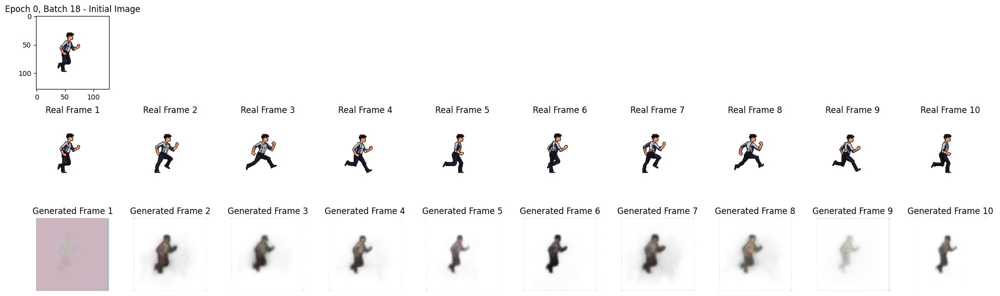

Epoch 2/150


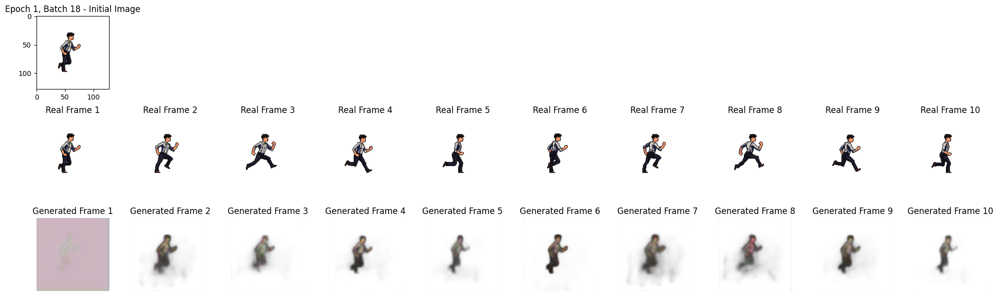

Epoch 3/150


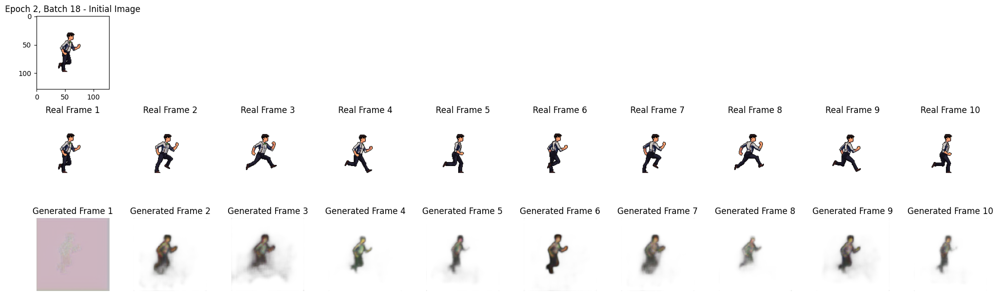

Epoch 4/150


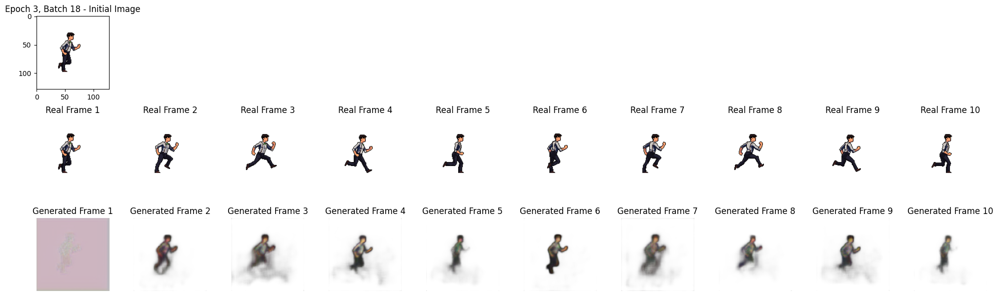

Epoch 5/150


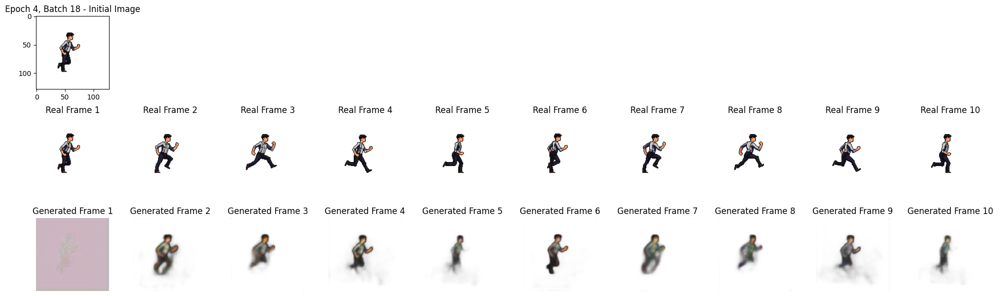

Epoch 6/150


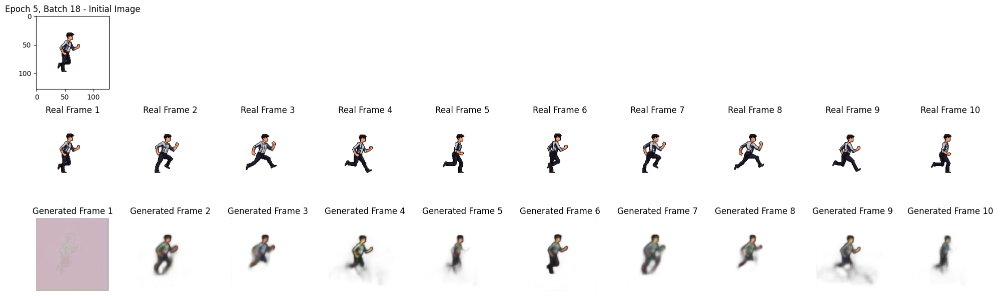

Epoch 7/150


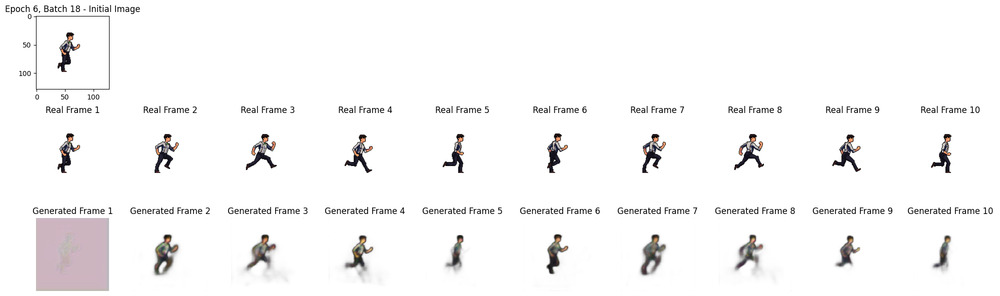

Epoch 8/150


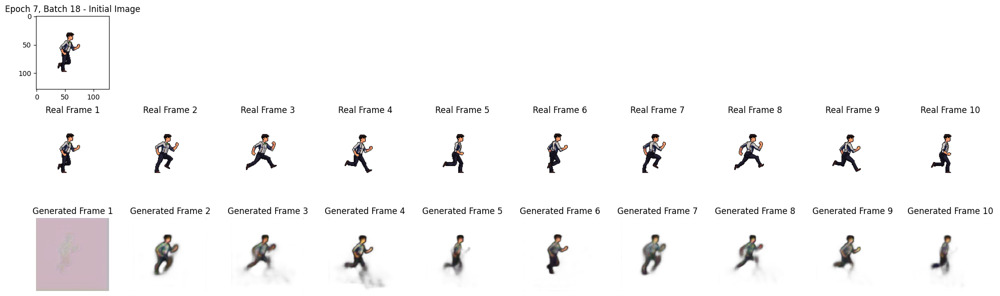

Epoch 9/150


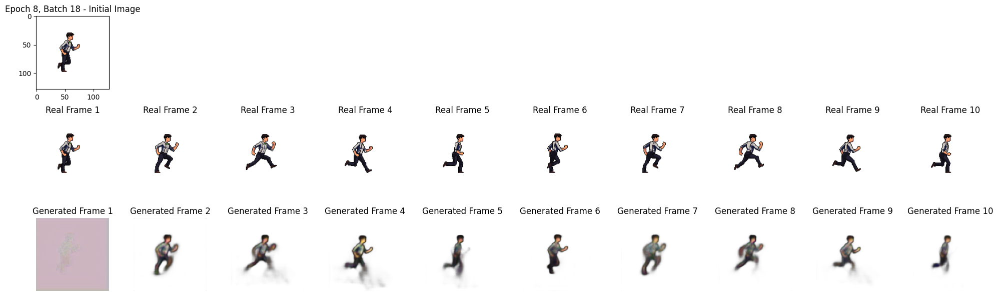

Epoch 10/150


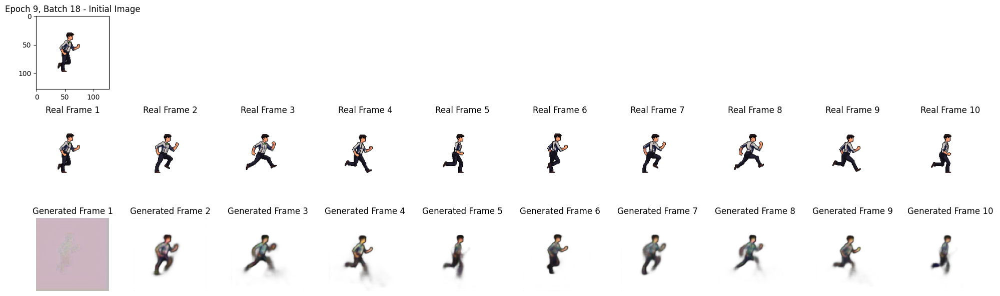

Epoch 11/150


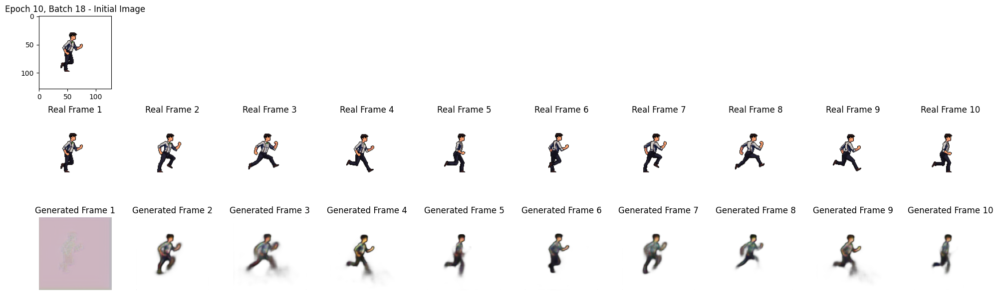

Epoch 12/150


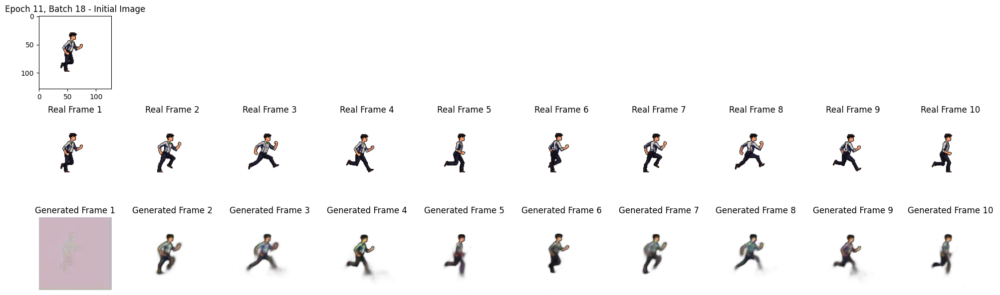

Epoch 13/150


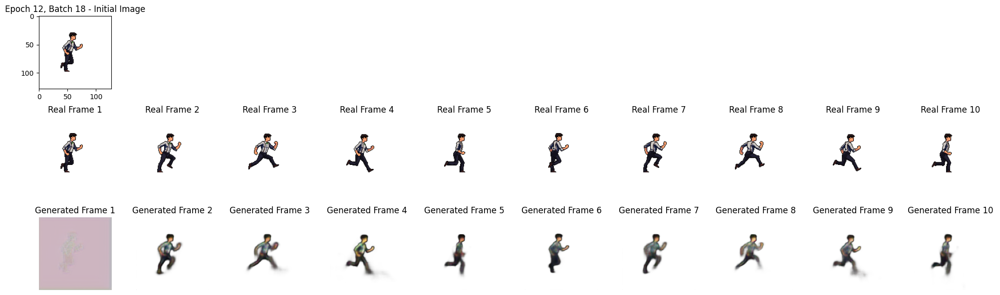

Epoch 14/150


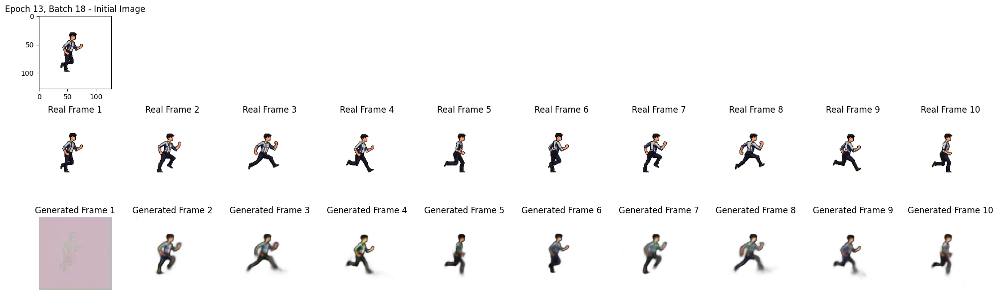

Epoch 15/150


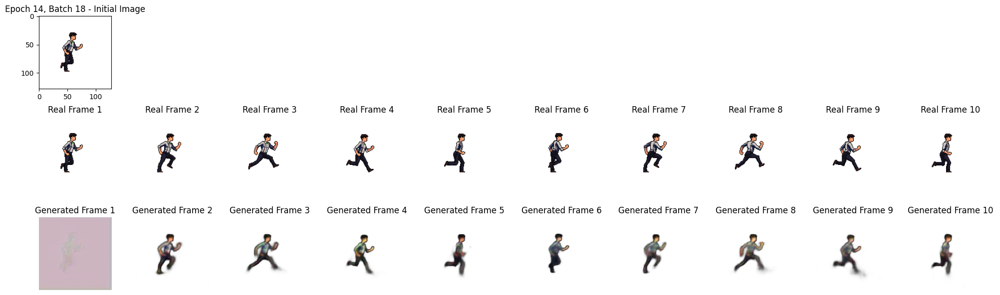

Epoch 16/150


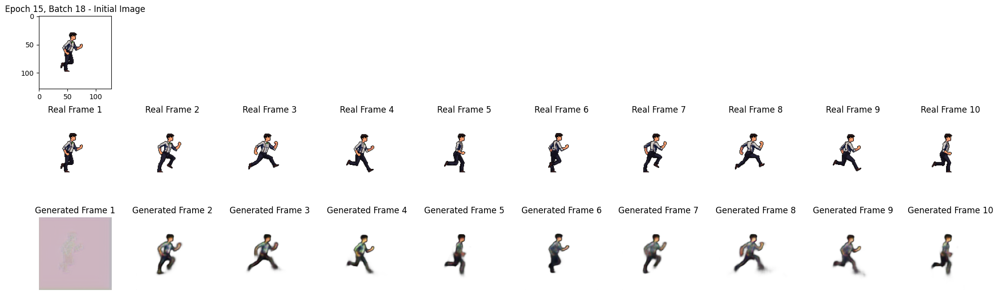

Epoch 17/150


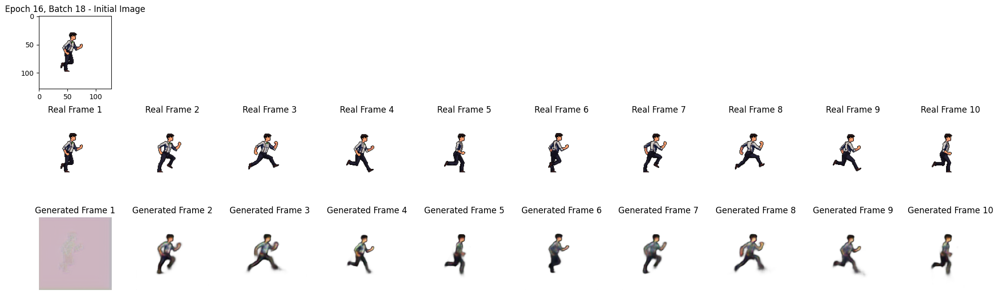

Epoch 18/150


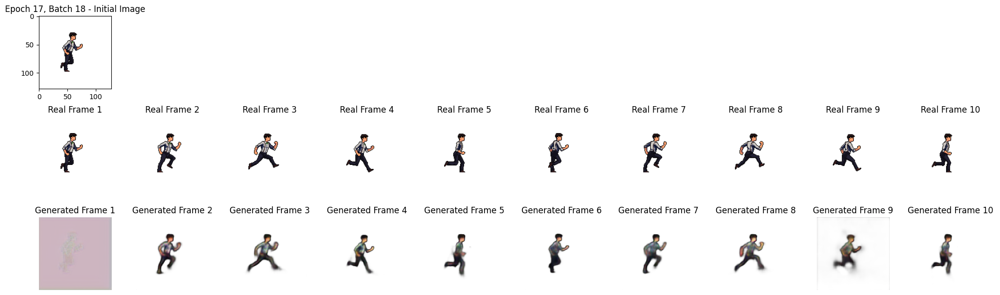

Epoch 19/150


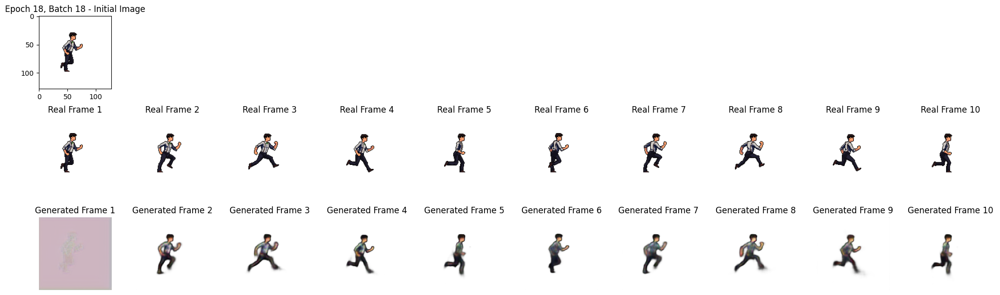

Epoch 20/150


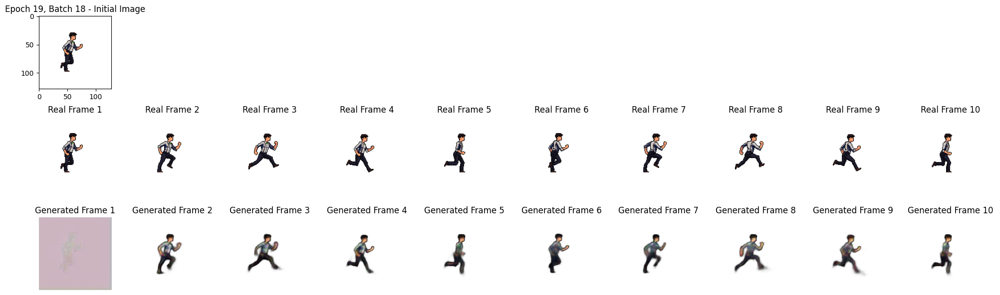

Epoch 21/150


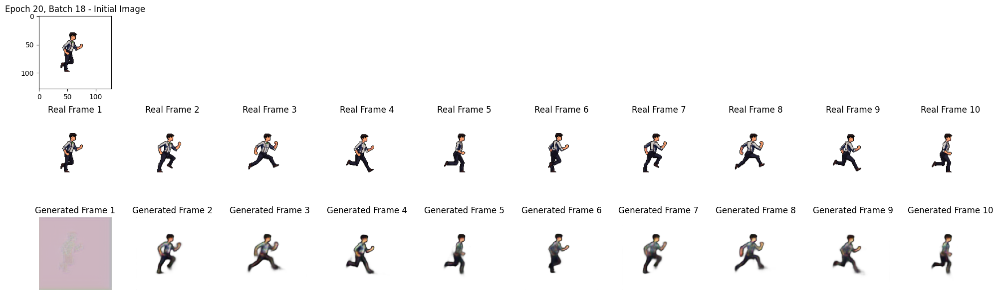

Epoch 22/150


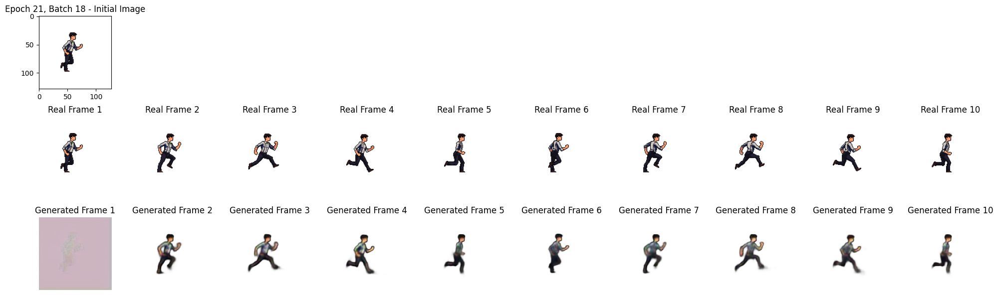

Epoch 23/150


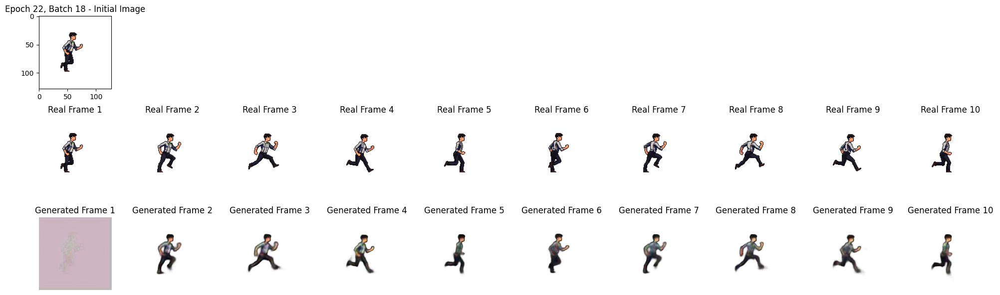

Epoch 24/150


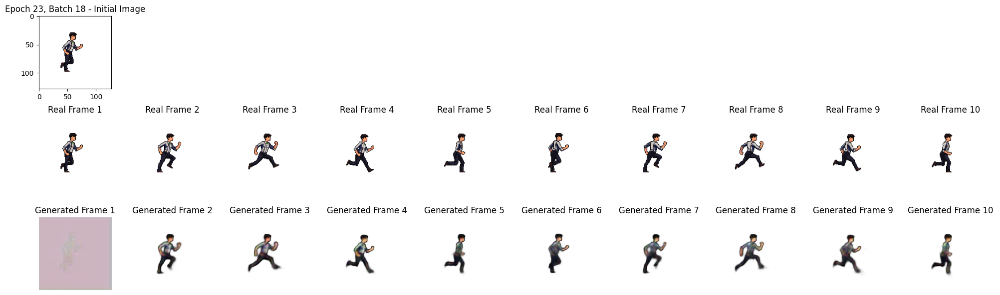

Epoch 25/150


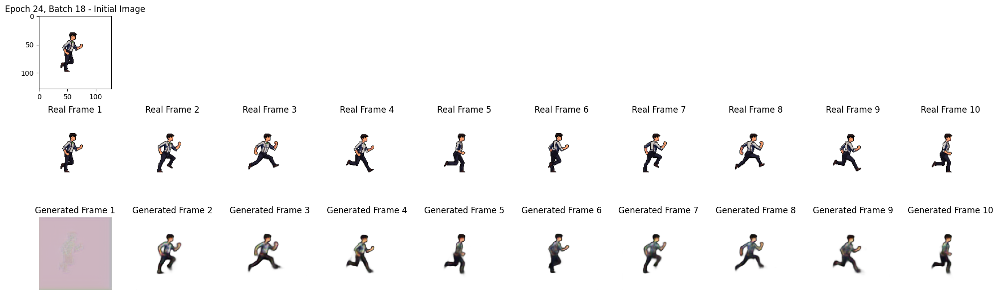

Epoch 26/150


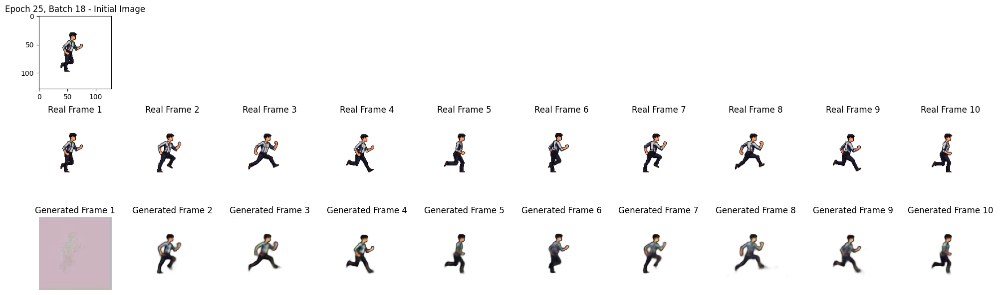

Epoch 27/150


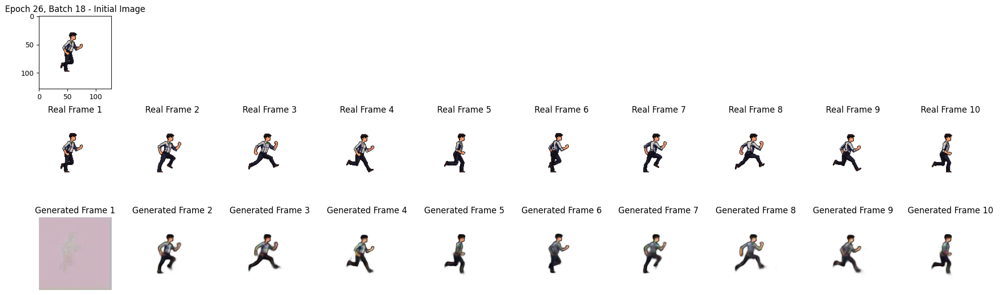

Epoch 28/150


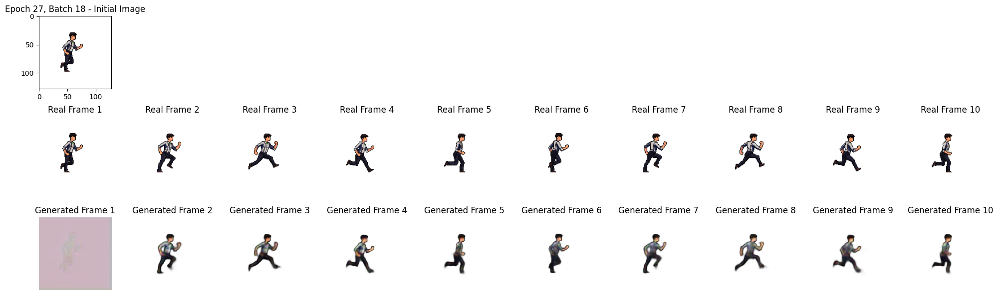

Epoch 29/150


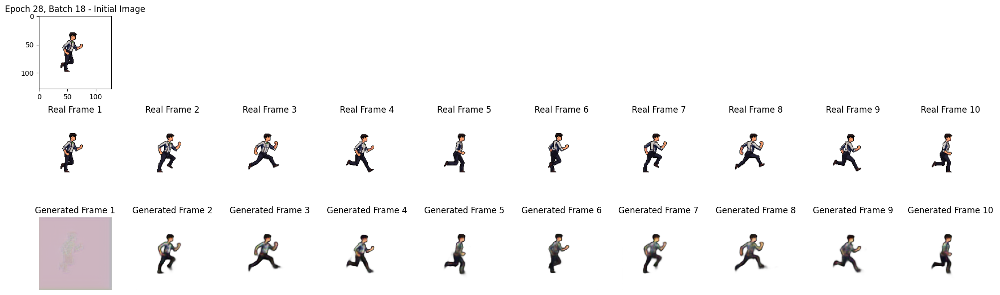

Epoch 30/150


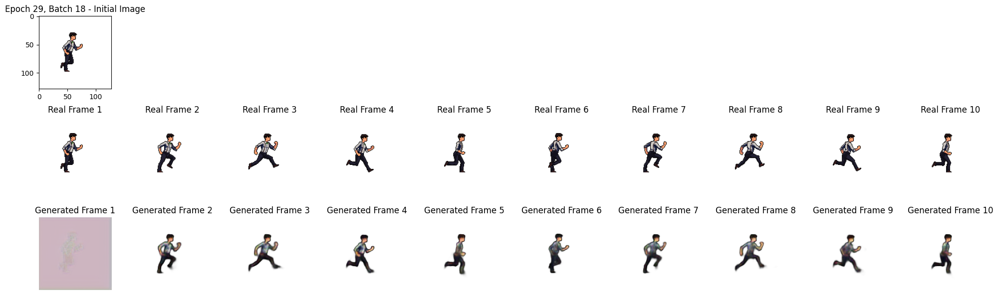

Epoch 31/150


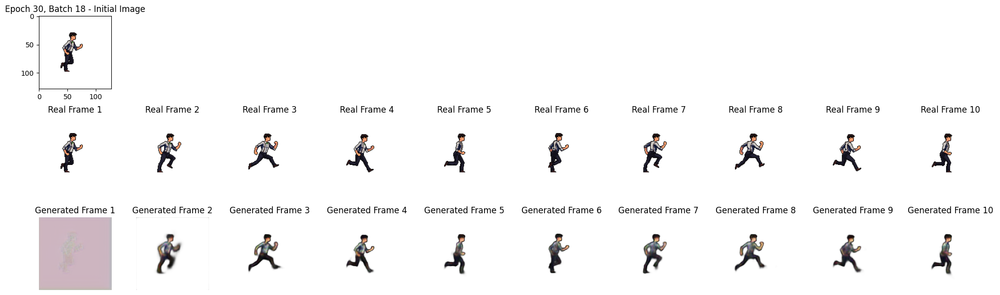

Epoch 32/150


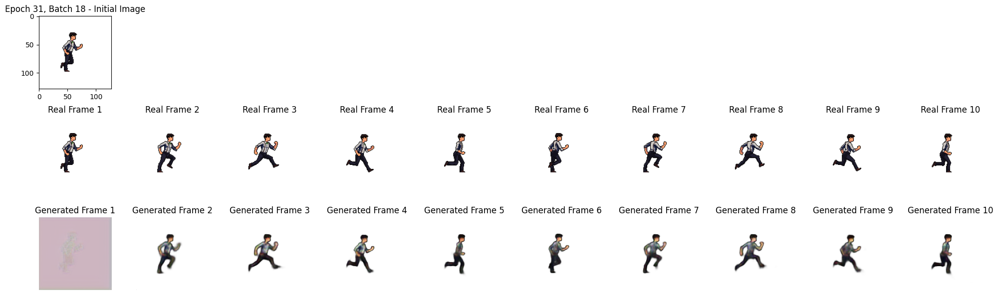

Epoch 33/150


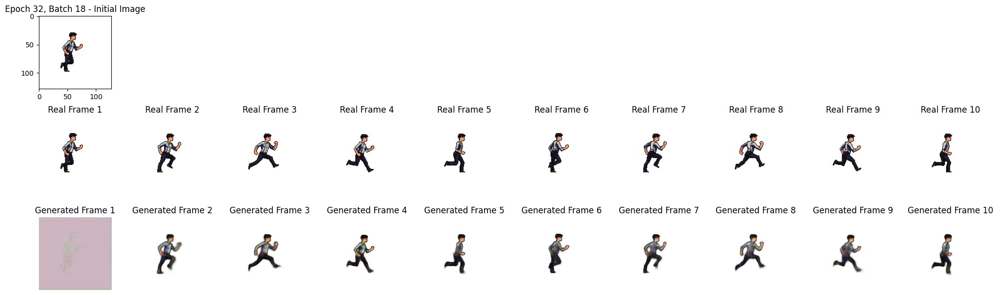

Epoch 34/150


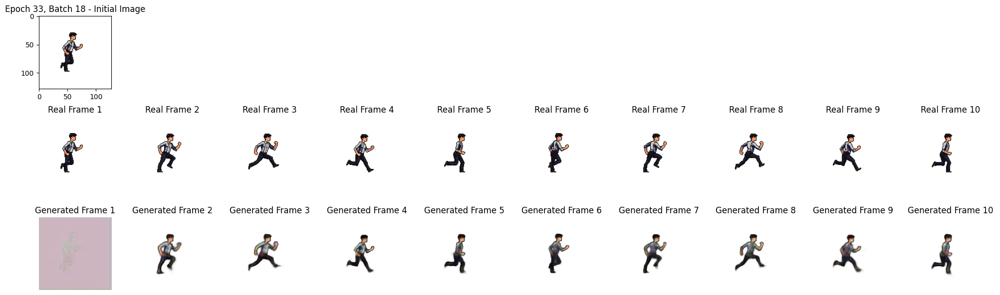

Epoch 35/150


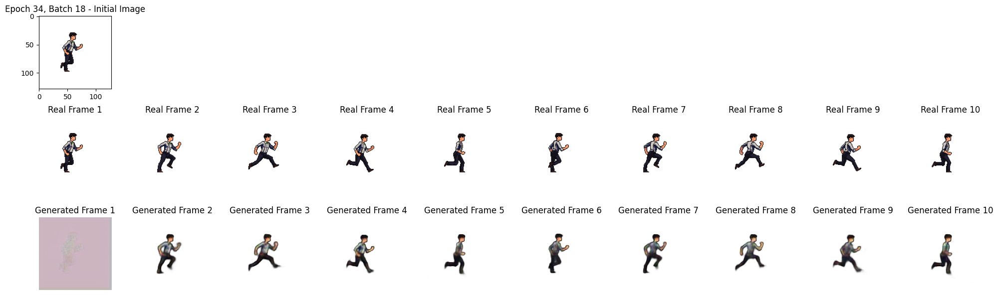

Epoch 36/150


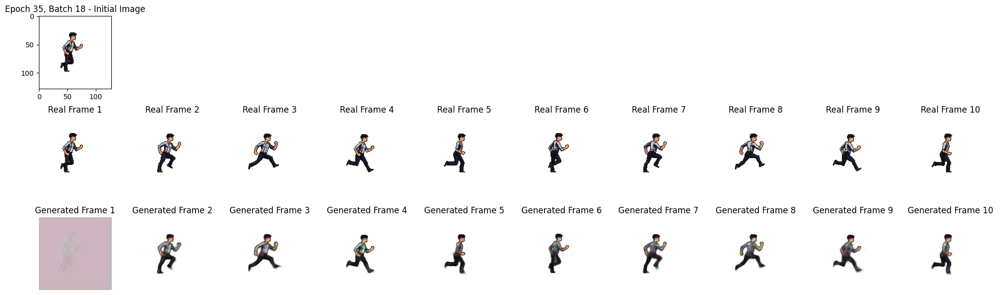

Epoch 37/150


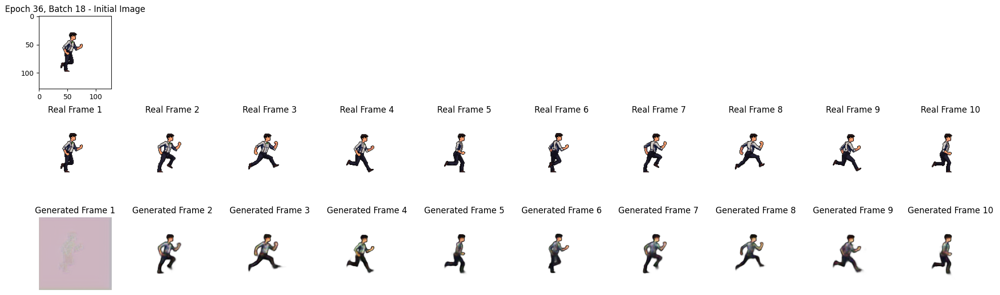

Epoch 38/150


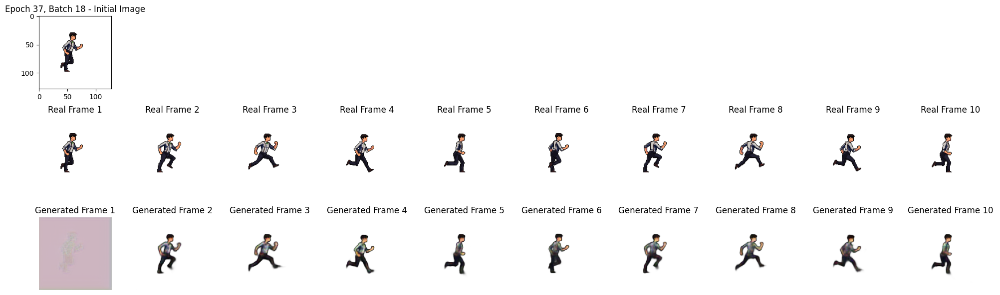

Epoch 39/150


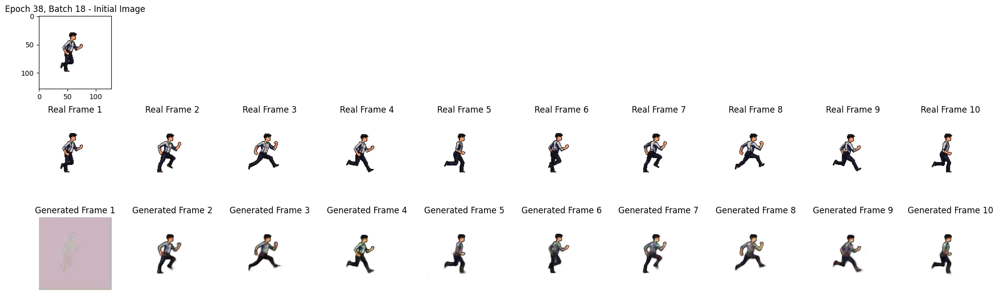

Epoch 40/150


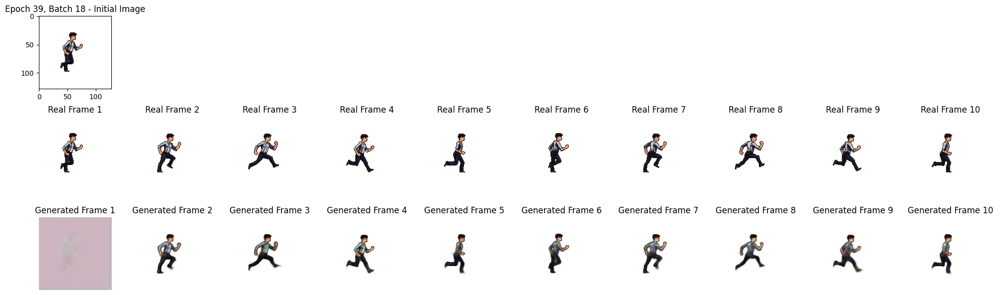

Epoch 41/150


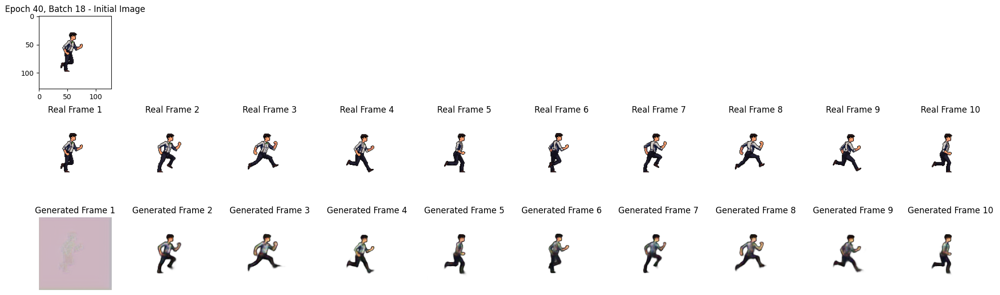

Epoch 42/150


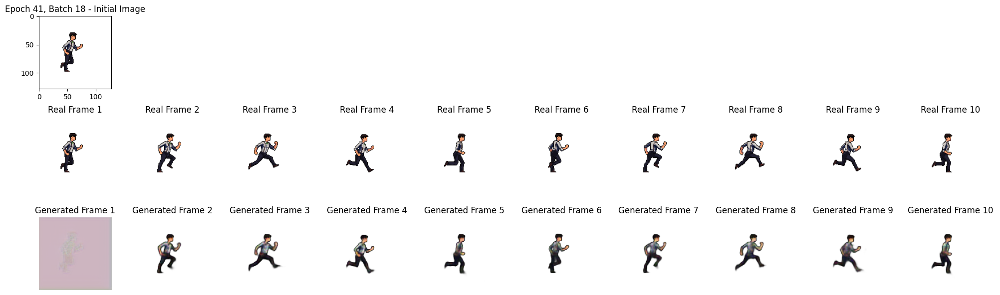

Epoch 43/150


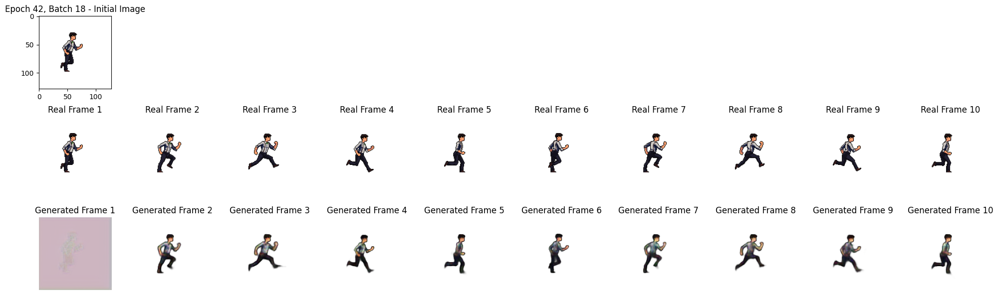

Epoch 44/150


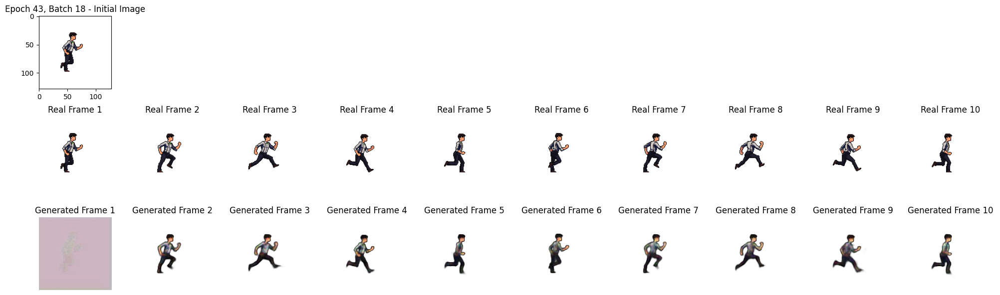

Epoch 45/150


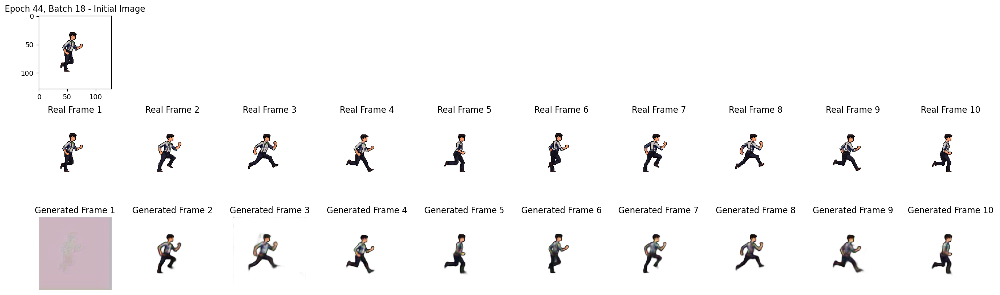

Epoch 46/150


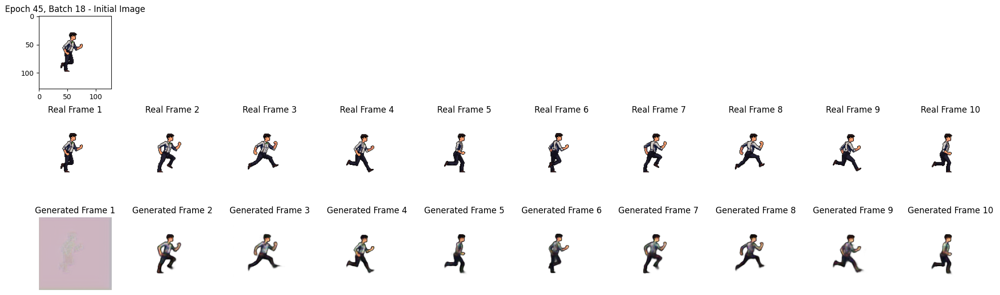

Epoch 47/150


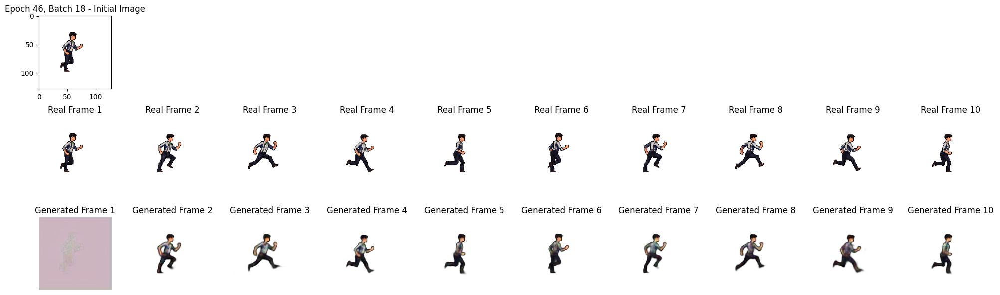

Epoch 48/150


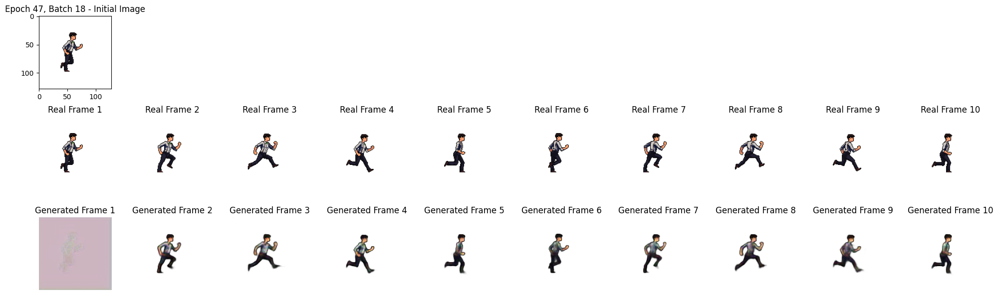

Epoch 49/150


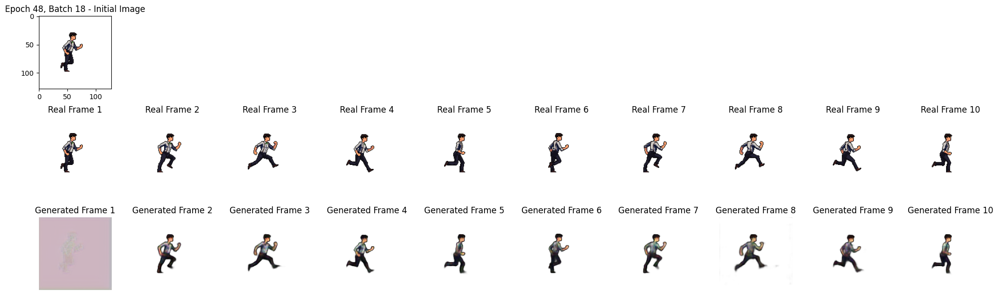

Epoch 50/150


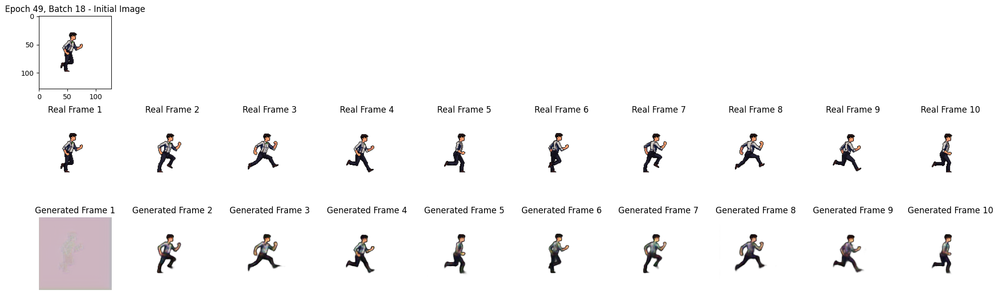

Epoch 51/150


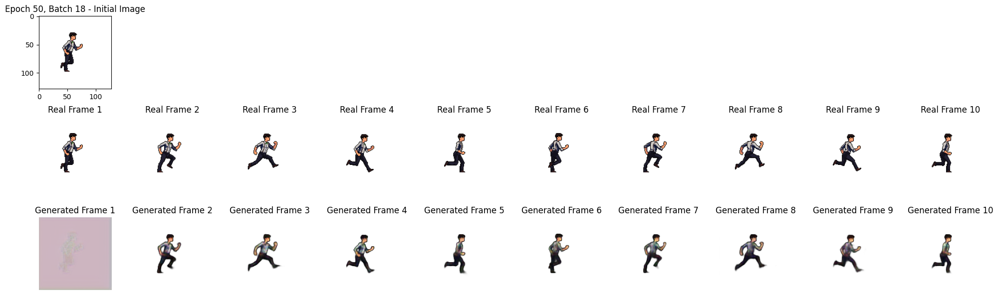

Epoch 52/150


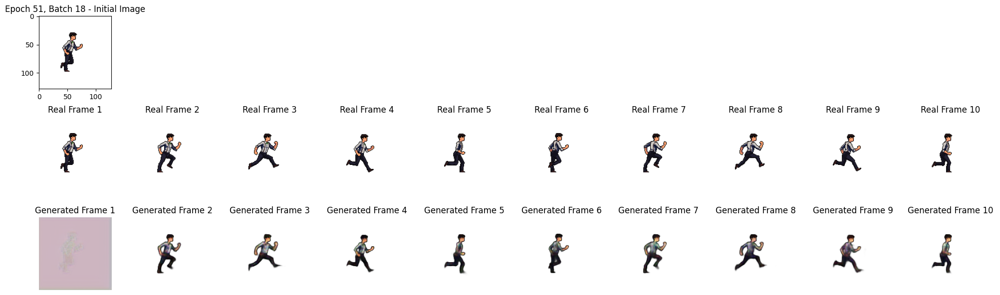

Epoch 53/150


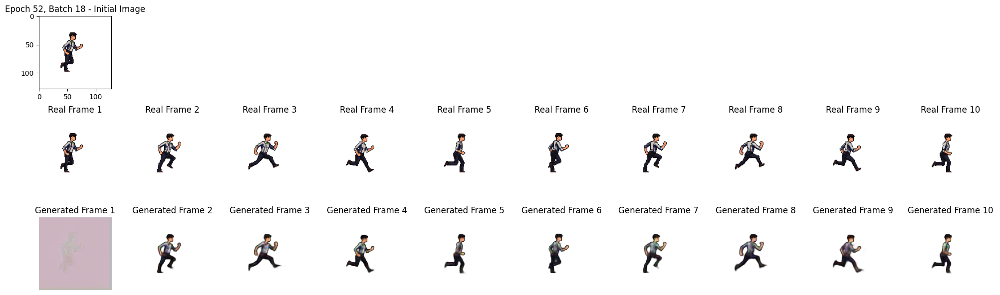

Epoch 54/150


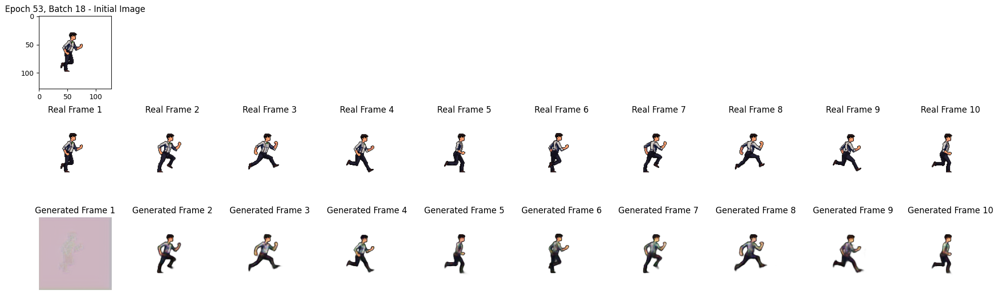

Epoch 55/150


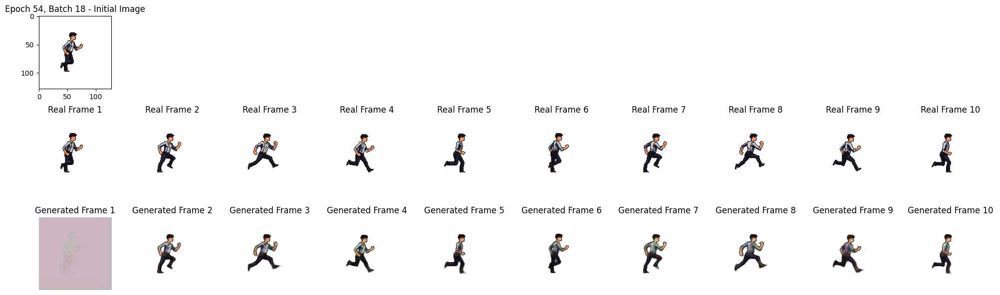

Epoch 56/150


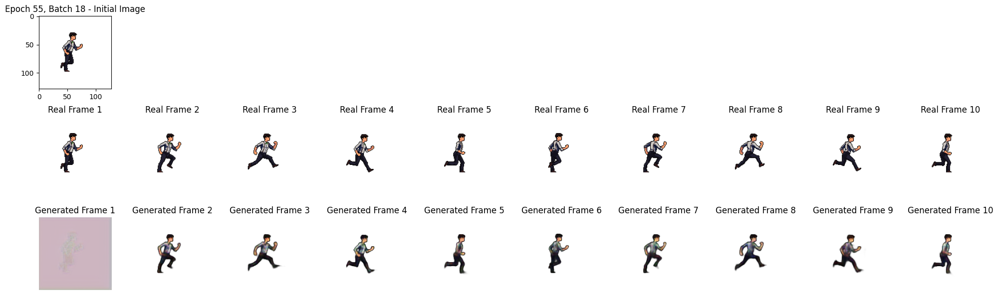

Epoch 57/150


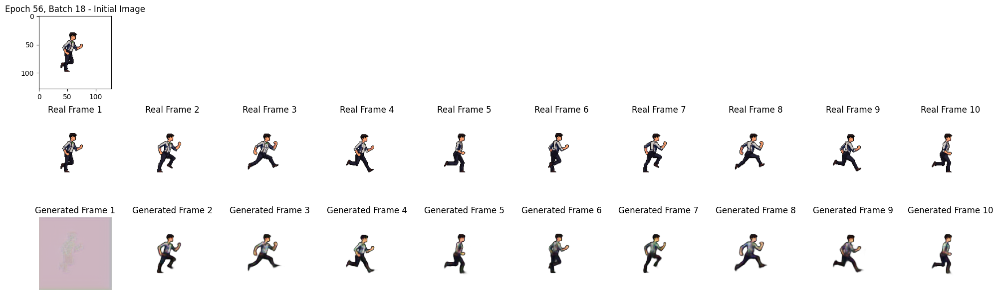

Epoch 58/150


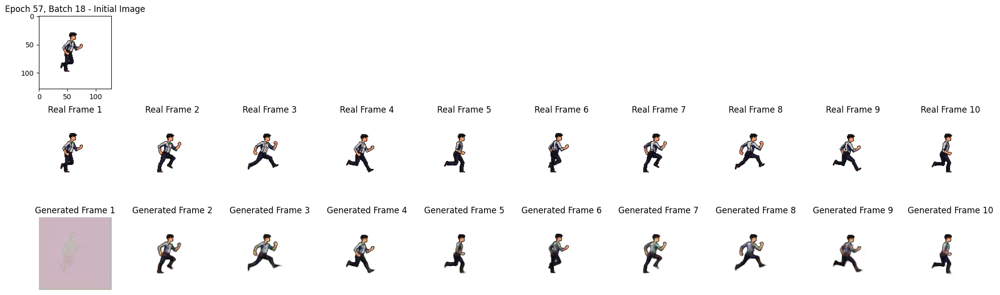

Epoch 59/150


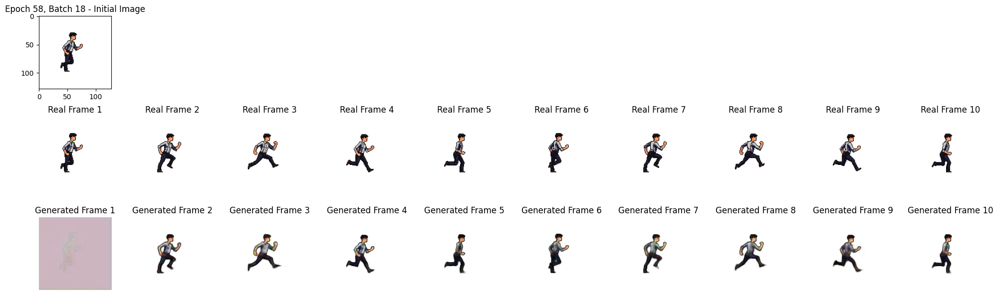

Epoch 60/150


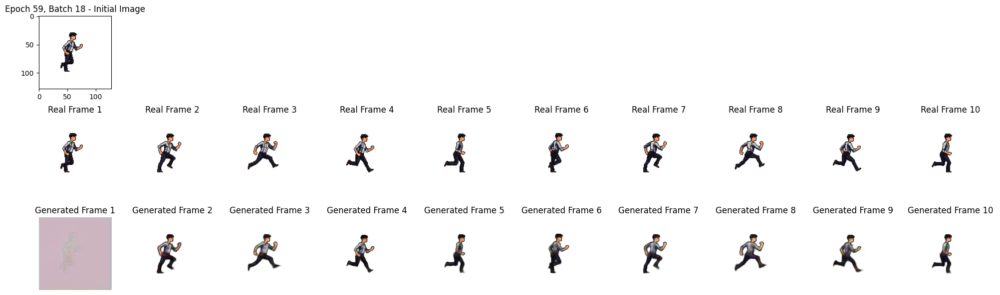

Epoch 61/150


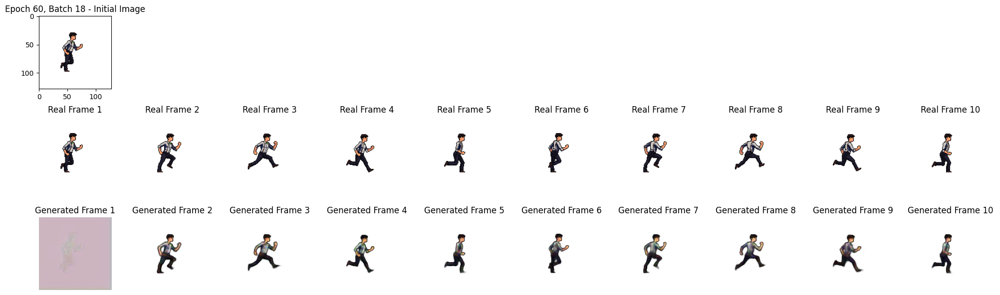

Epoch 62/150


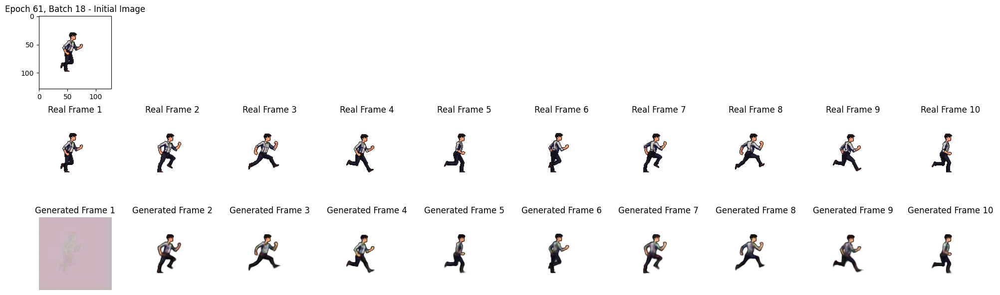

Epoch 63/150


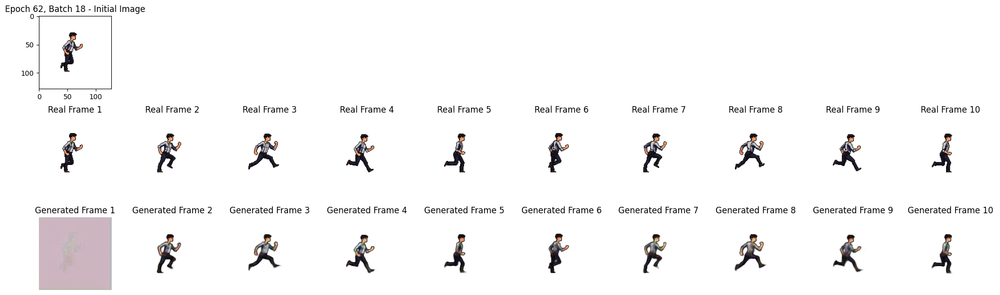

Epoch 64/150


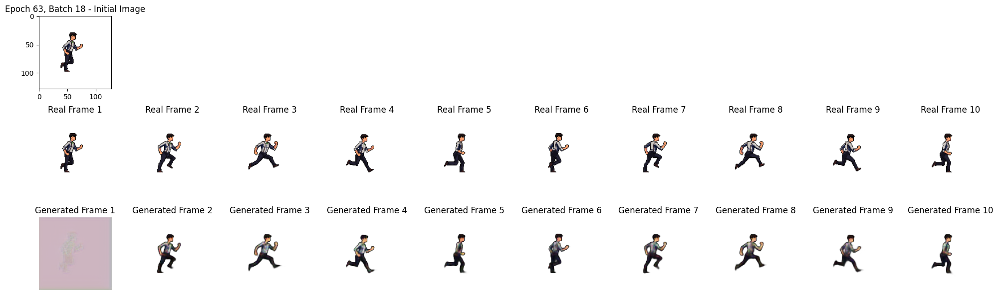

Epoch 65/150


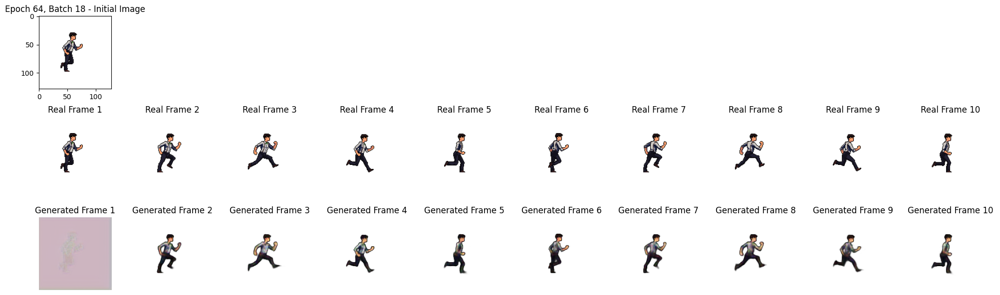

Epoch 66/150


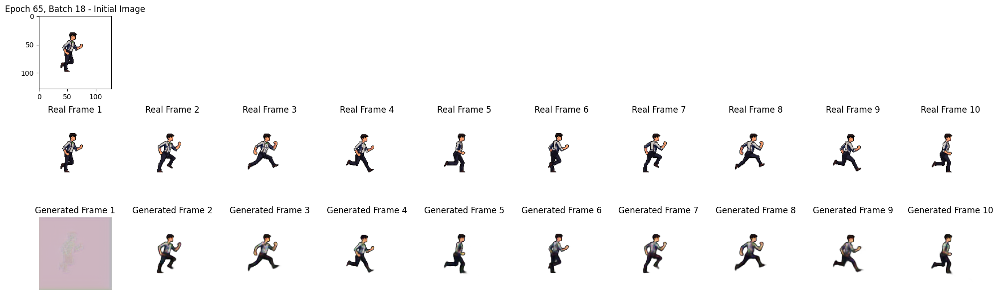

Epoch 67/150


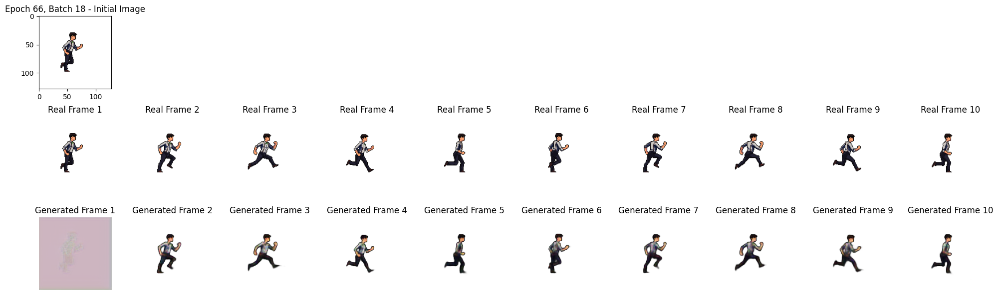

Epoch 68/150


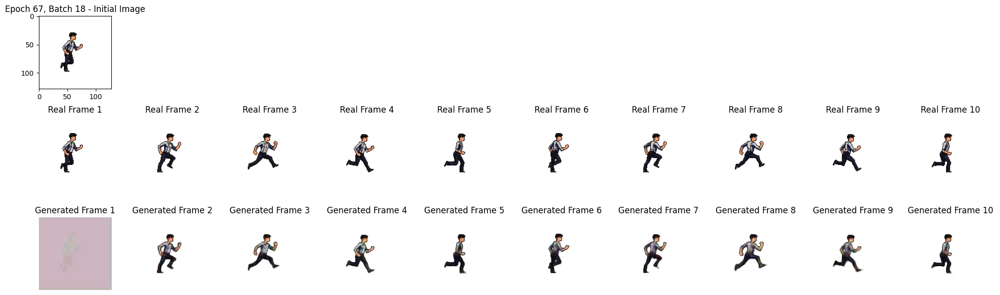

Epoch 69/150


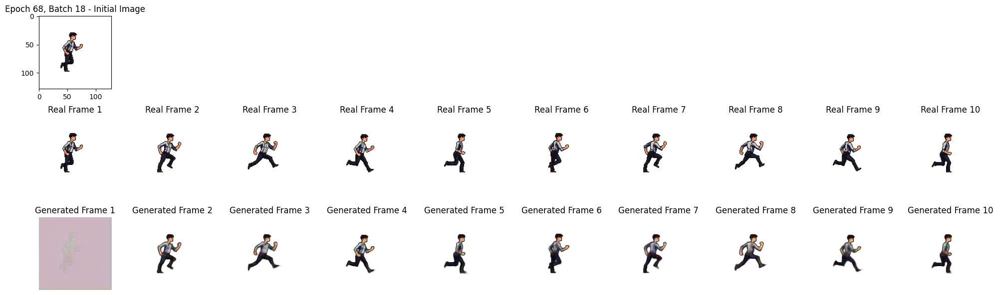

Epoch 70/150


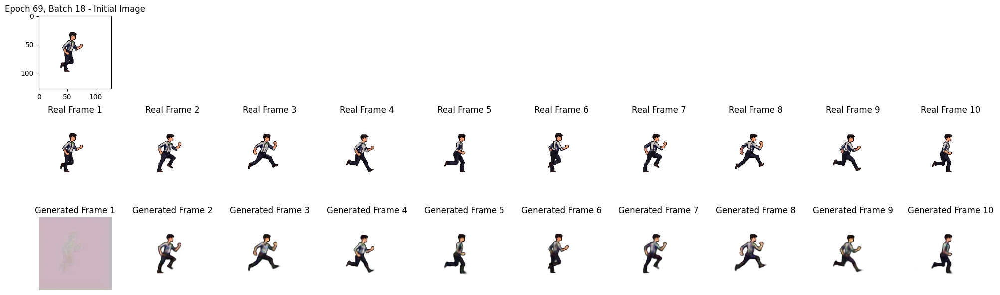

Epoch 71/150


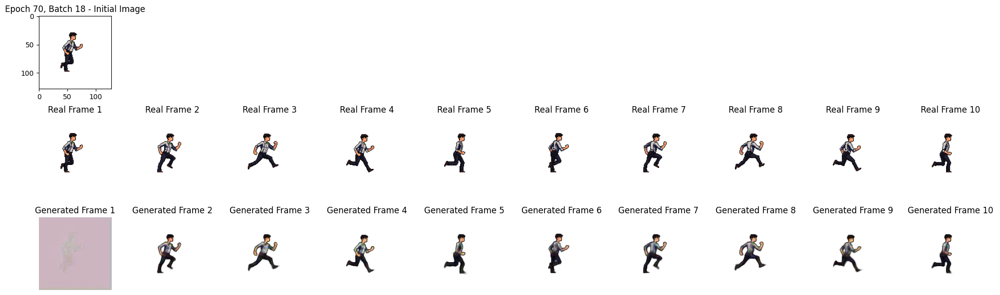

Epoch 72/150


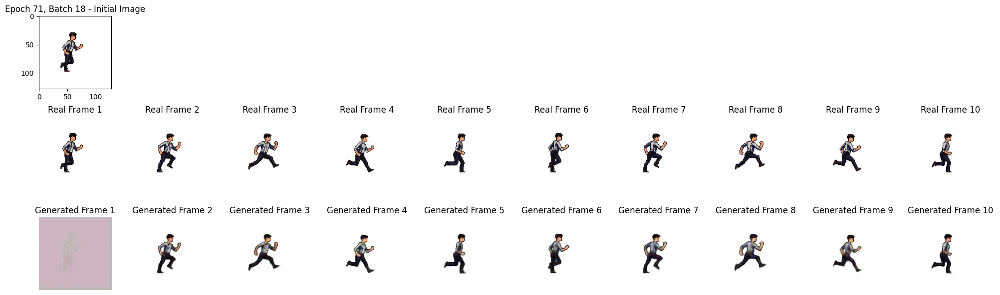

Epoch 73/150


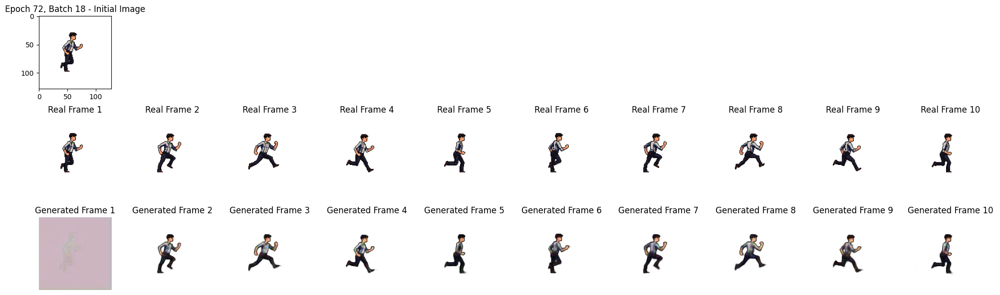

Epoch 74/150


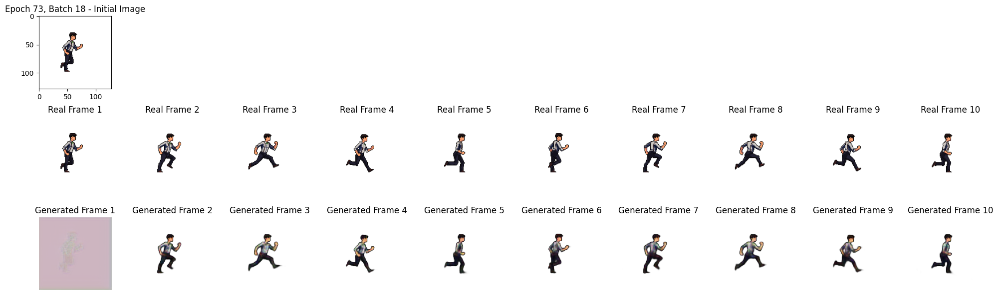

Epoch 75/150


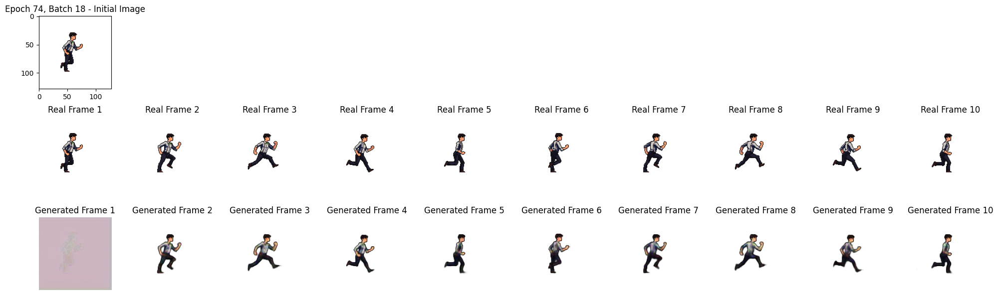

Epoch 76/150


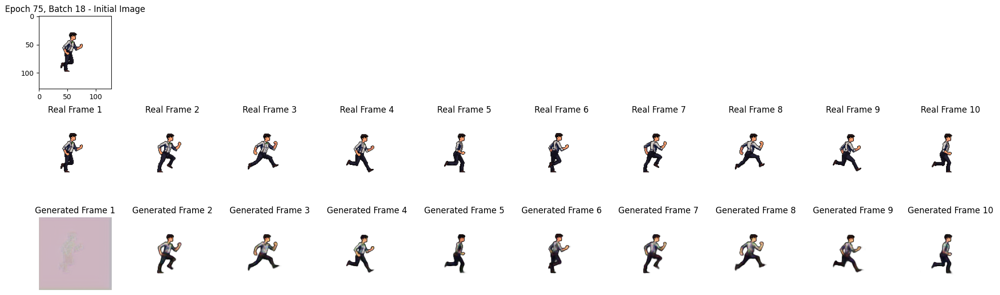

Epoch 77/150


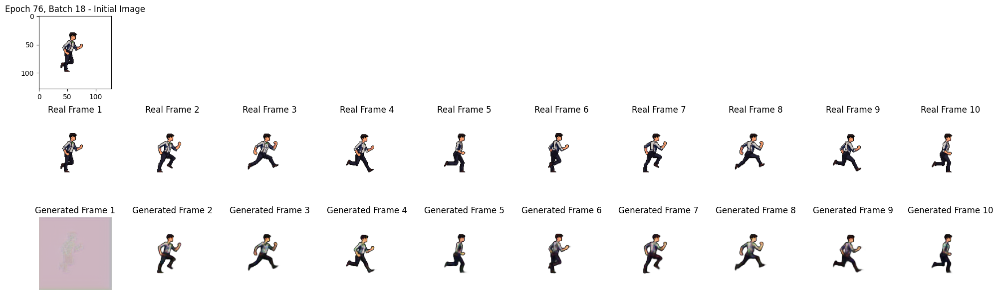

Epoch 78/150


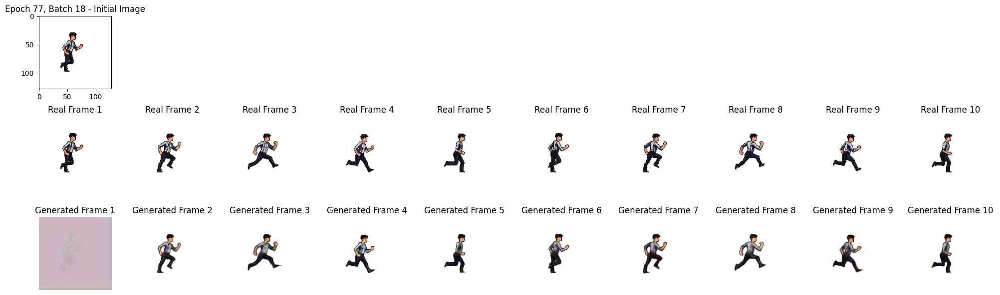

Epoch 79/150


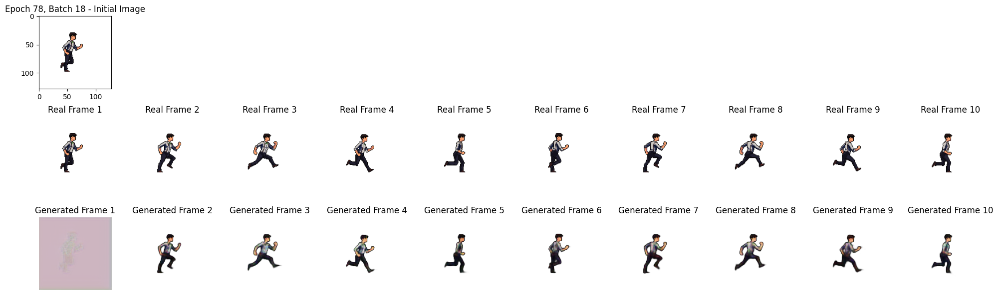

Epoch 80/150


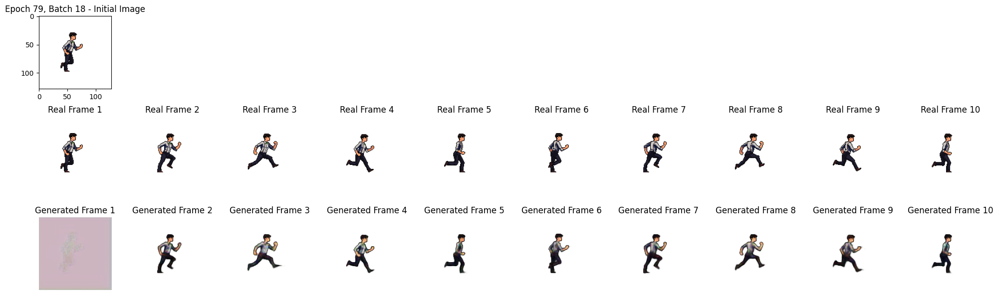

Epoch 81/150


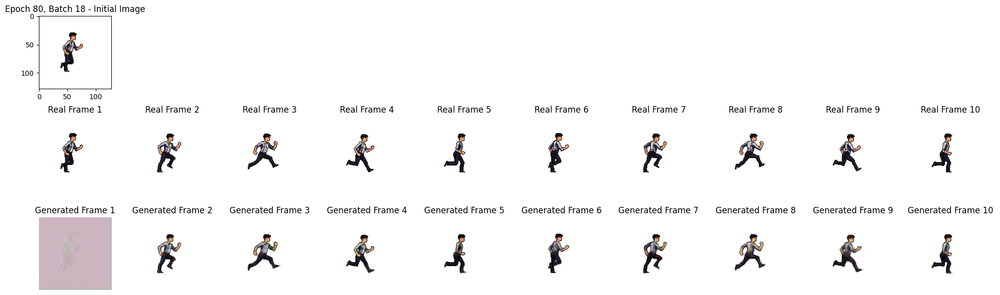

Epoch 82/150


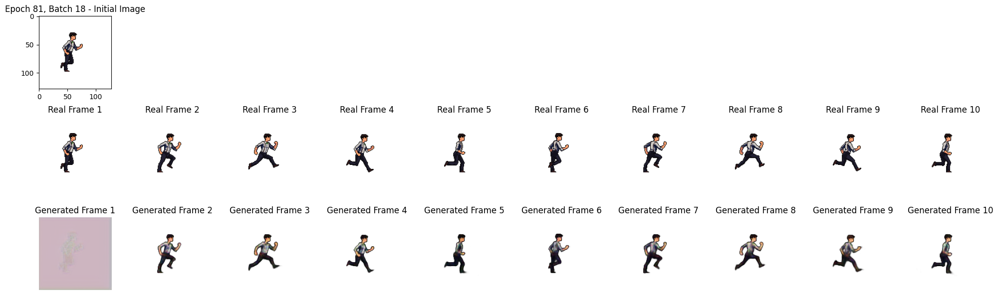

Epoch 83/150


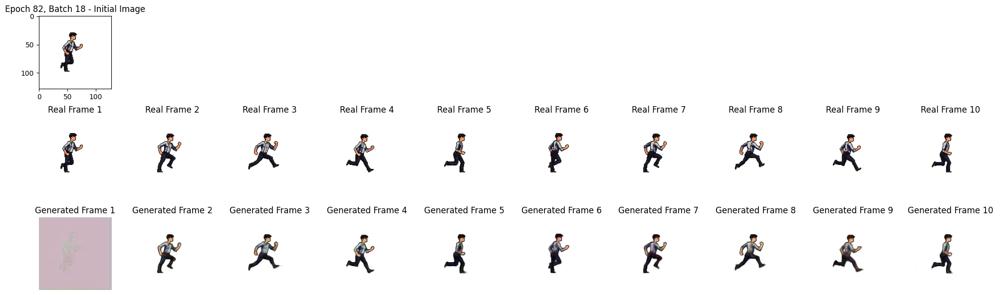

Epoch 84/150


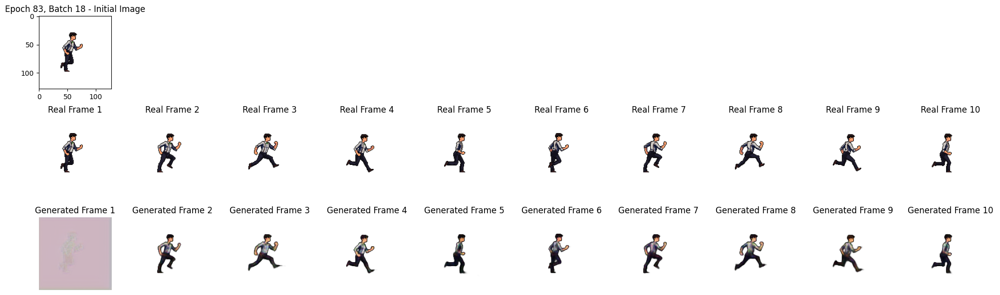

Epoch 85/150


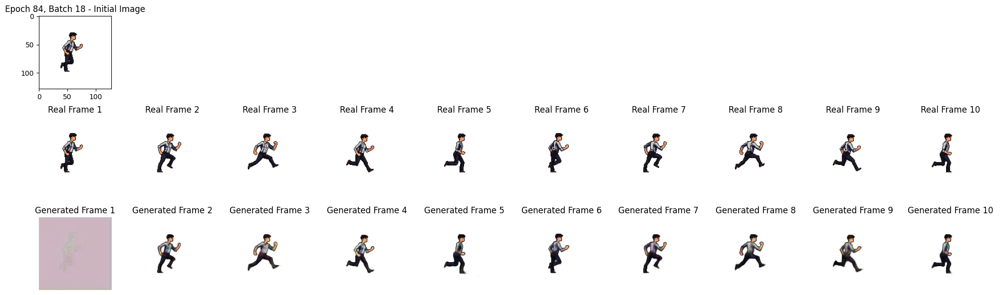

Epoch 86/150


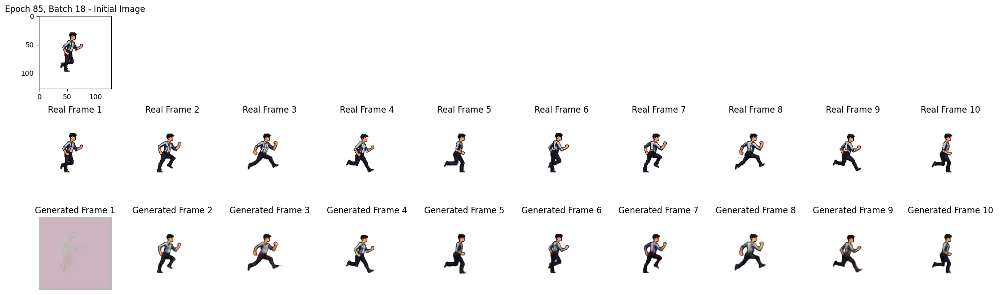

Epoch 87/150


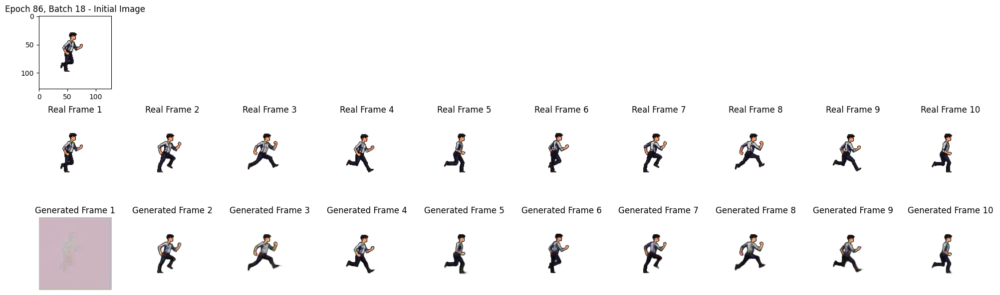

Epoch 88/150


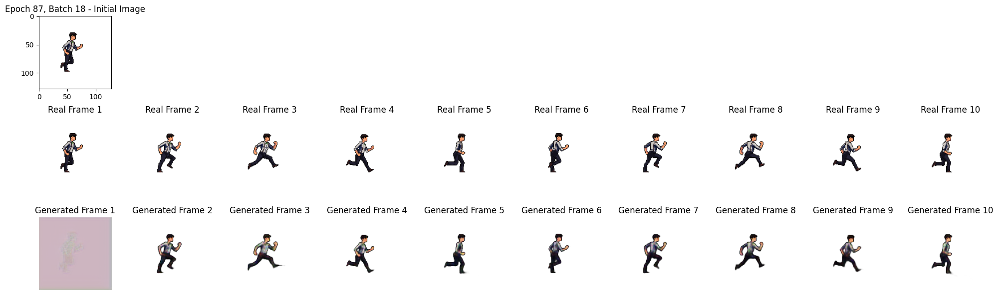

Epoch 89/150


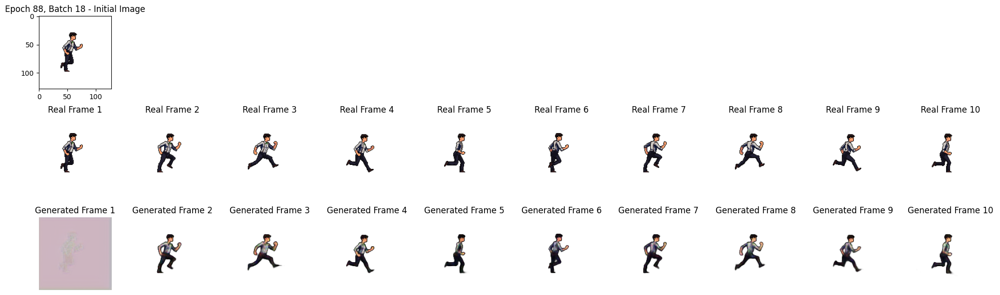

Epoch 90/150


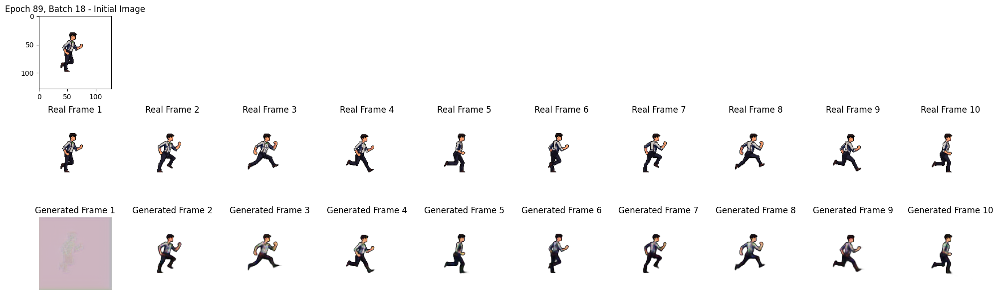

Epoch 91/150


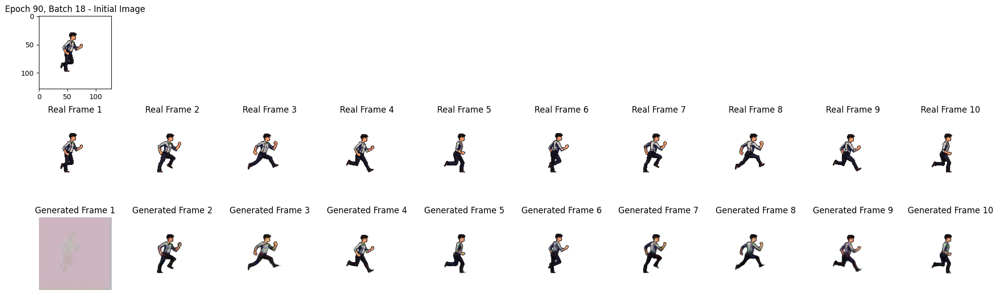

Epoch 92/150


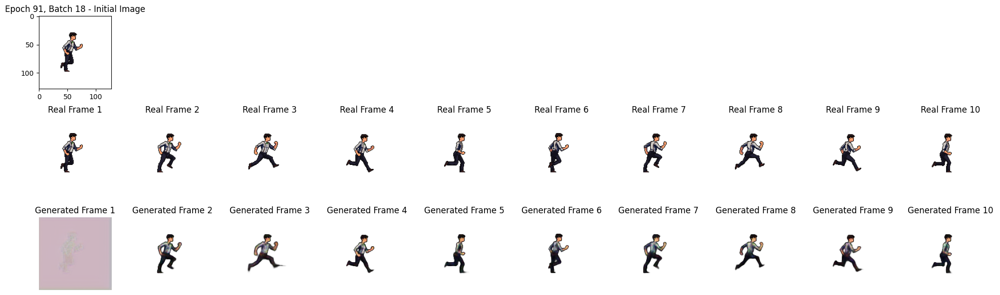

Epoch 93/150


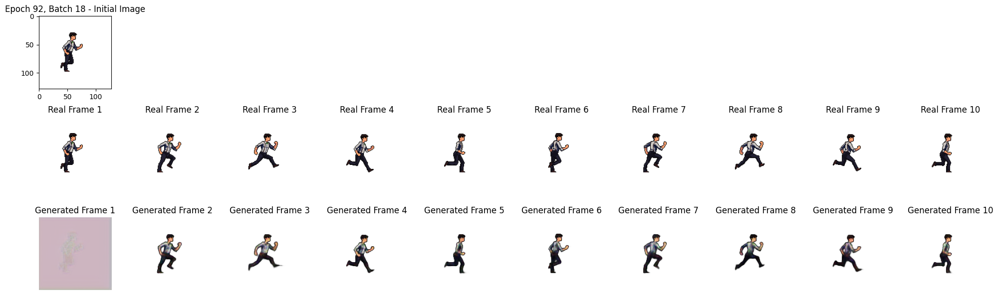

Epoch 94/150


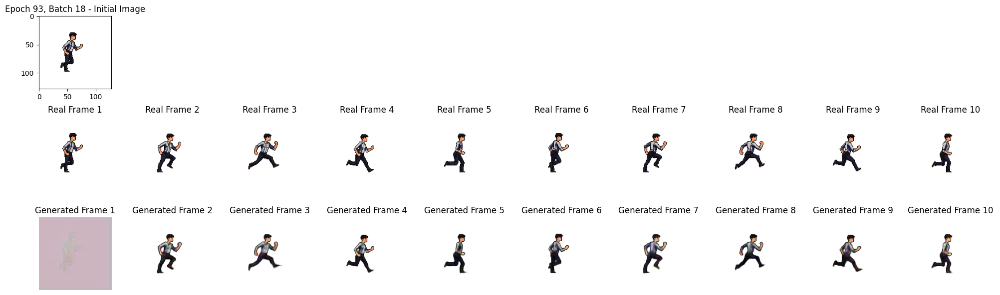

Epoch 95/150


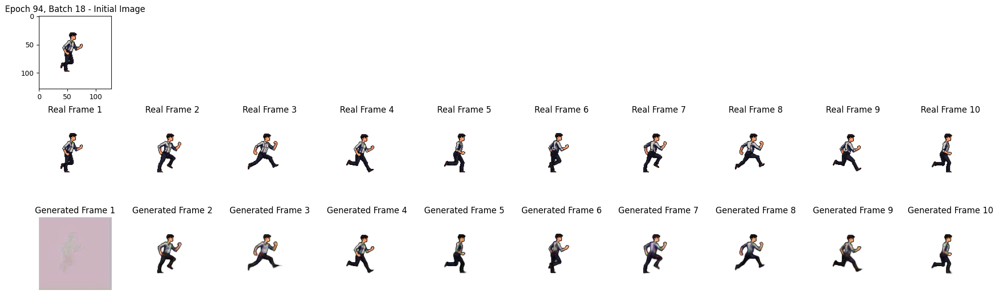

Epoch 96/150


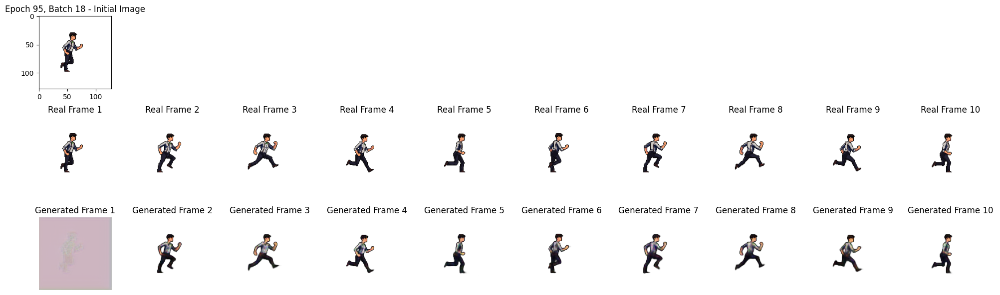

Epoch 97/150


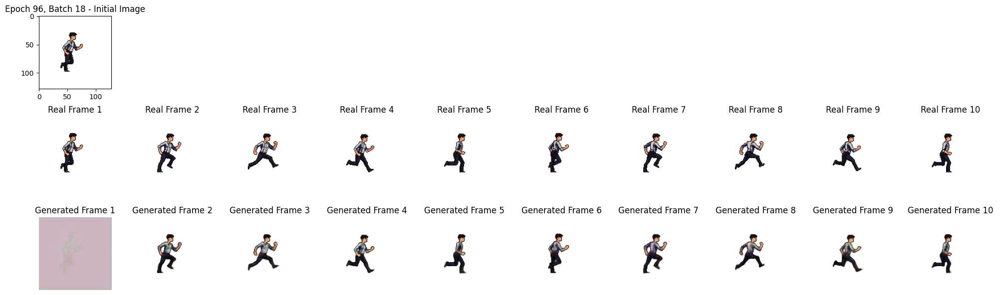

Epoch 98/150


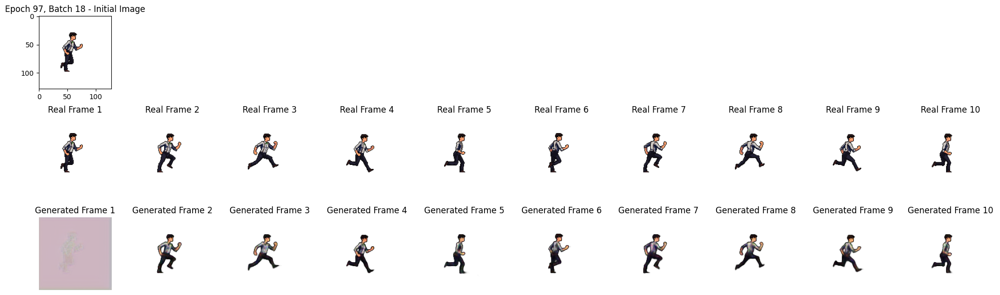

Epoch 99/150


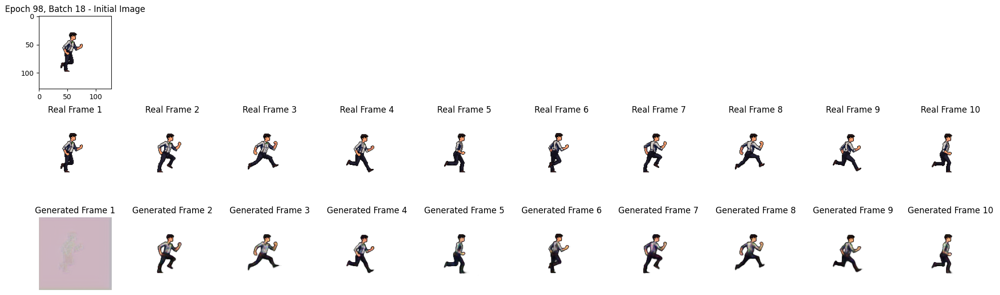

Epoch 100/150


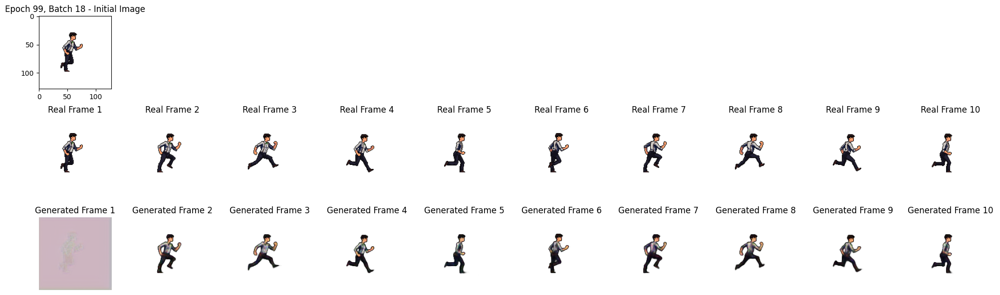

Epoch 101/150


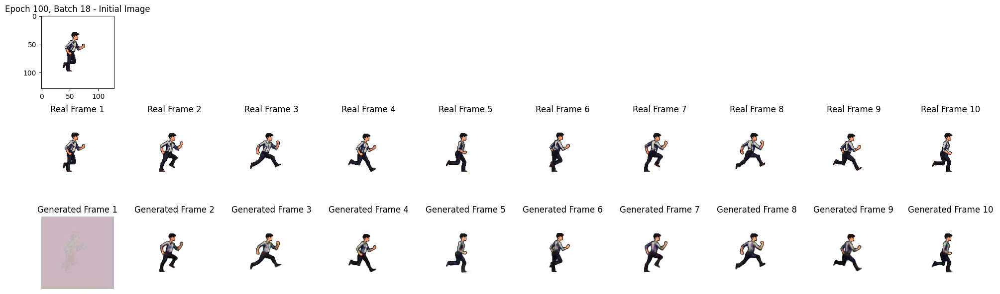

Epoch 102/150


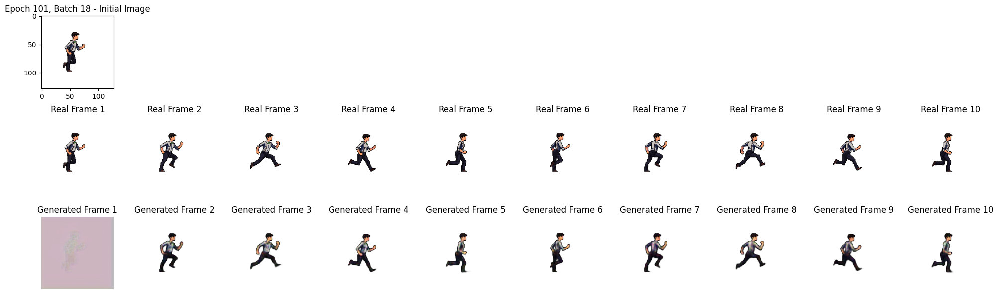

Epoch 103/150


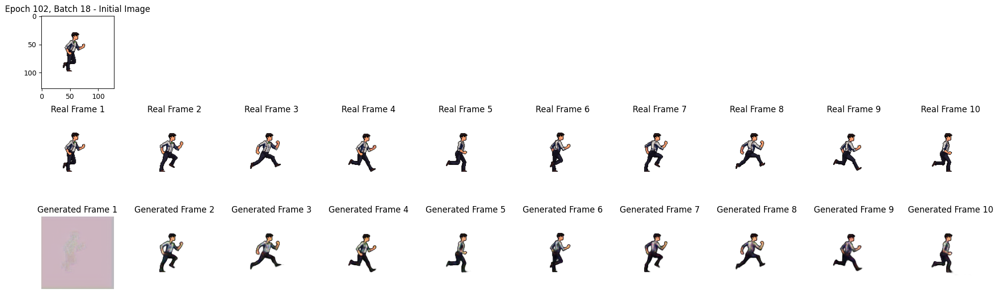

Epoch 104/150


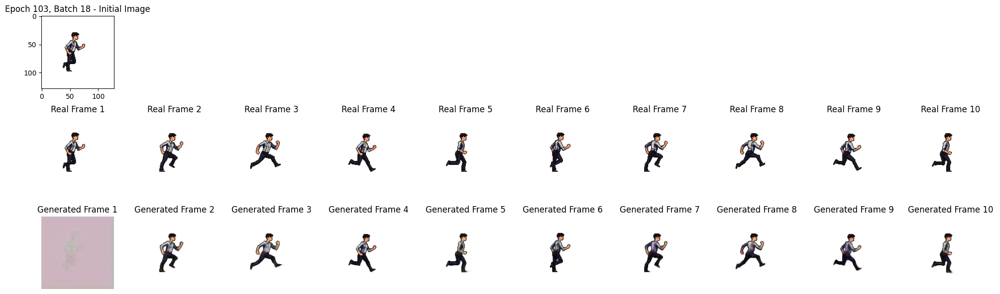

Epoch 105/150


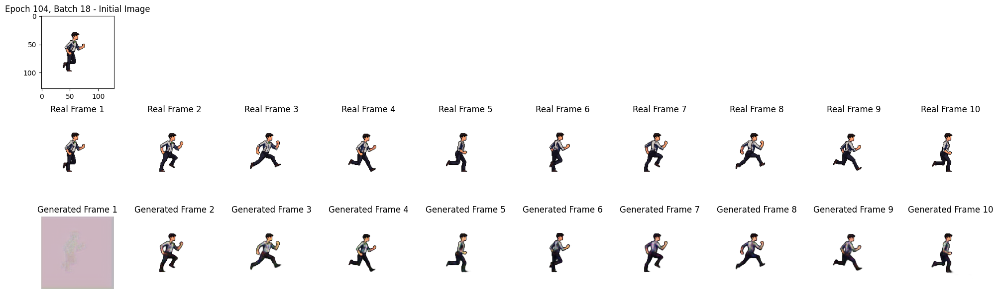

Epoch 106/150


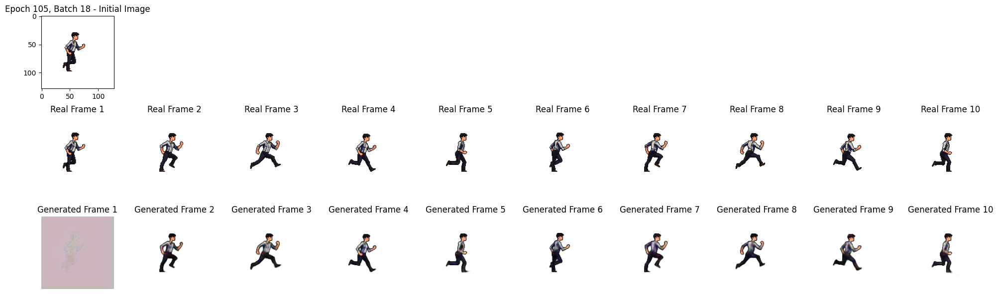

Epoch 107/150


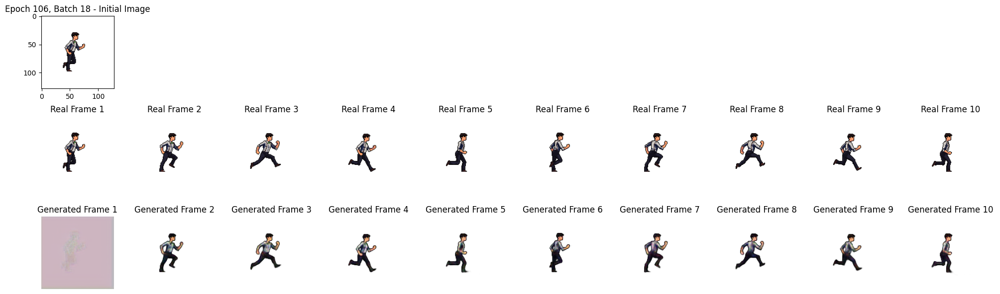

Epoch 108/150


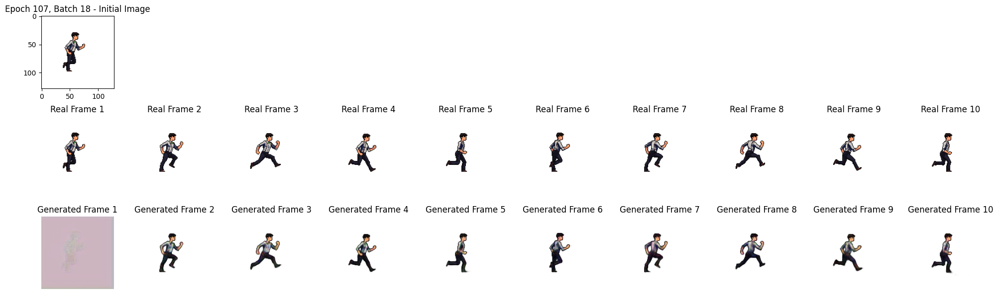

Epoch 109/150


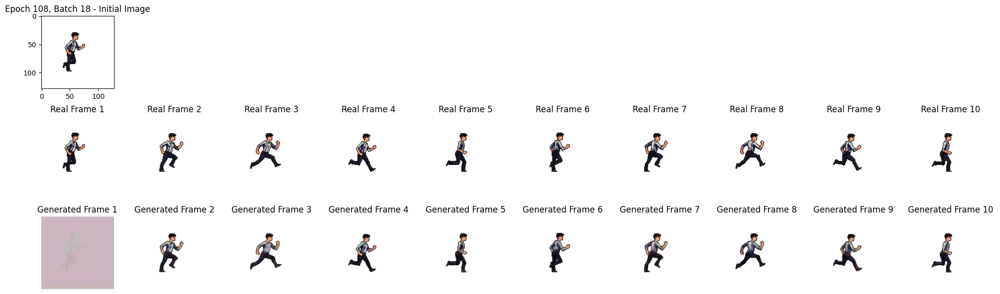

Epoch 110/150


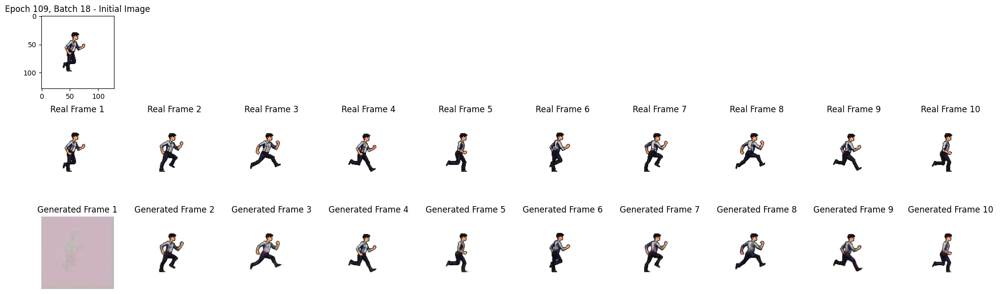

Epoch 111/150


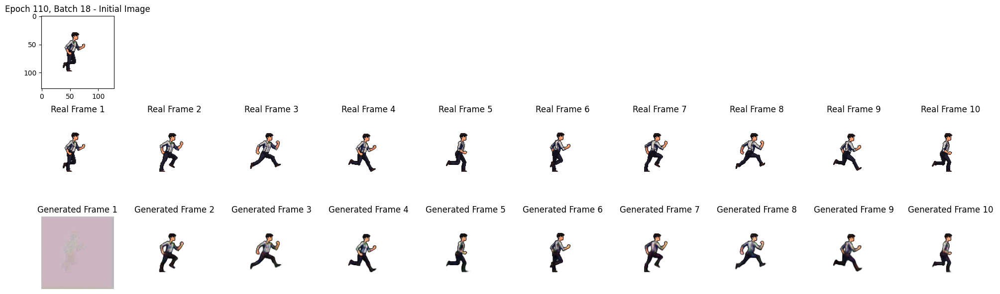

Epoch 112/150


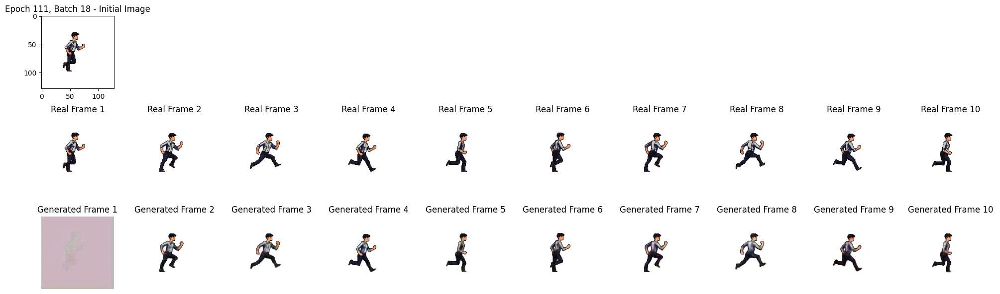

Epoch 113/150


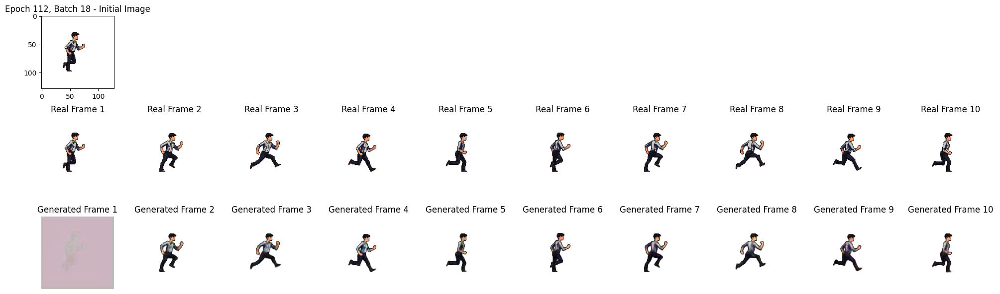

Epoch 114/150


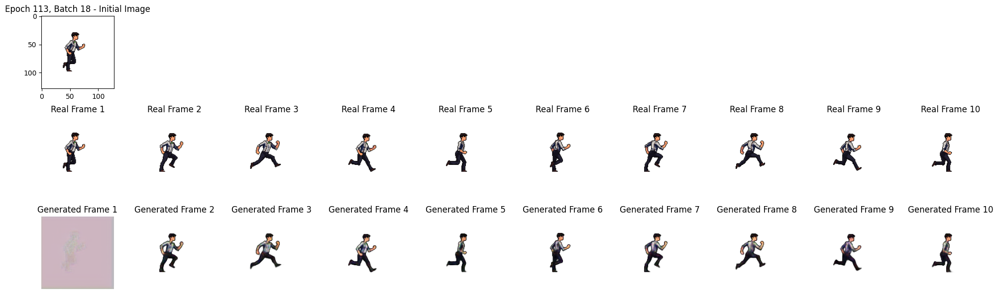

Epoch 115/150


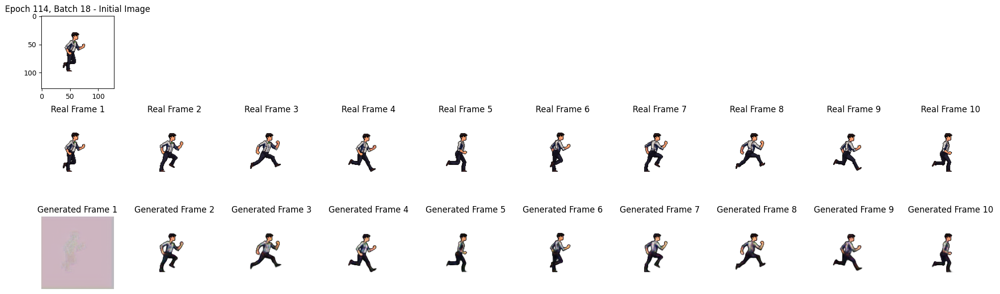

Epoch 116/150


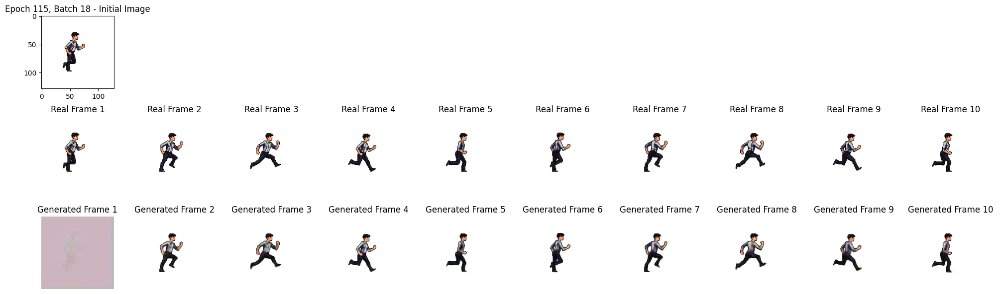

Epoch 117/150


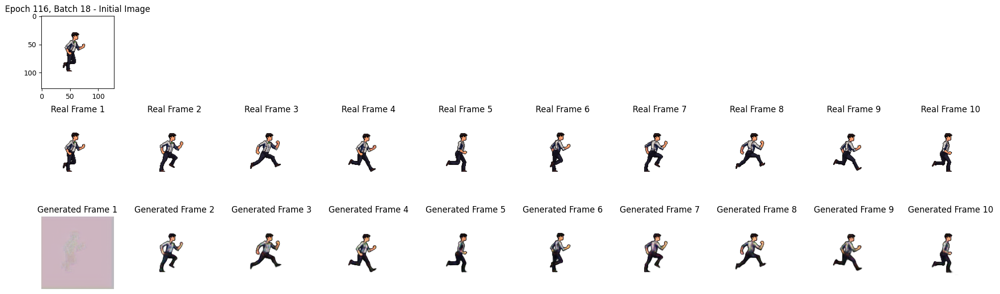

Epoch 118/150


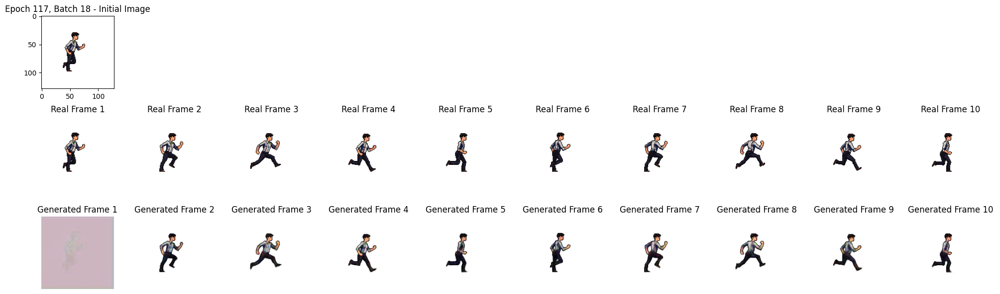

Epoch 119/150


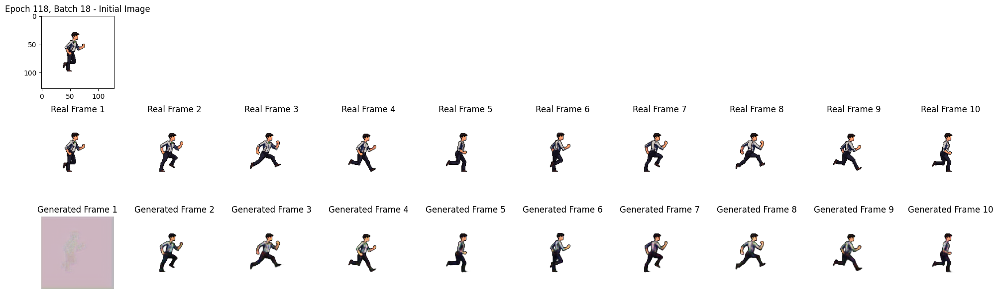

Epoch 120/150


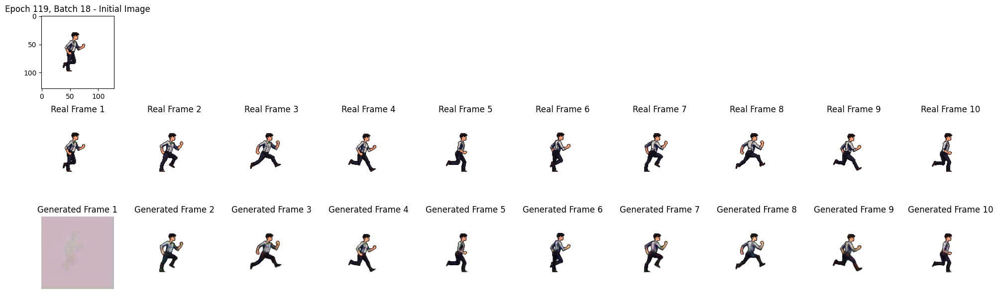

Epoch 121/150


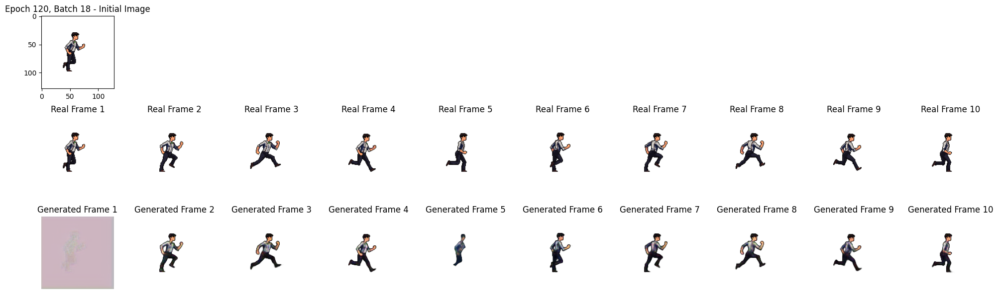

Epoch 122/150


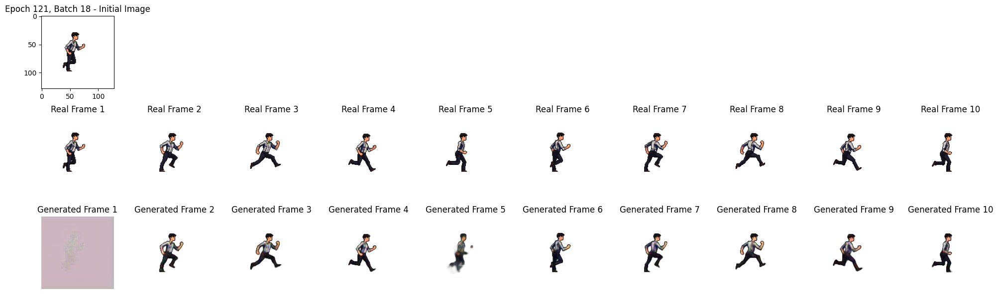

Epoch 123/150


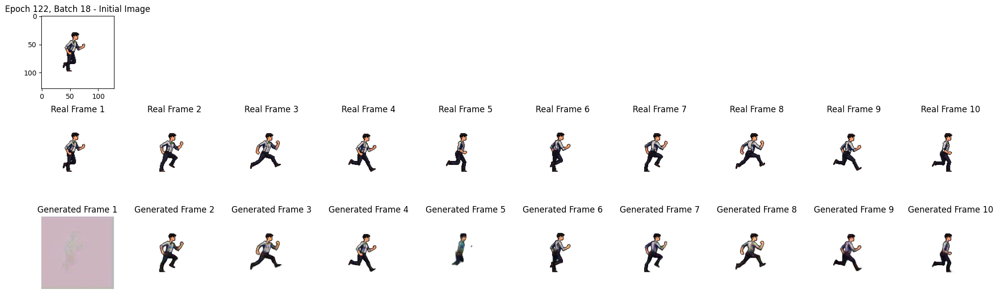

Epoch 124/150


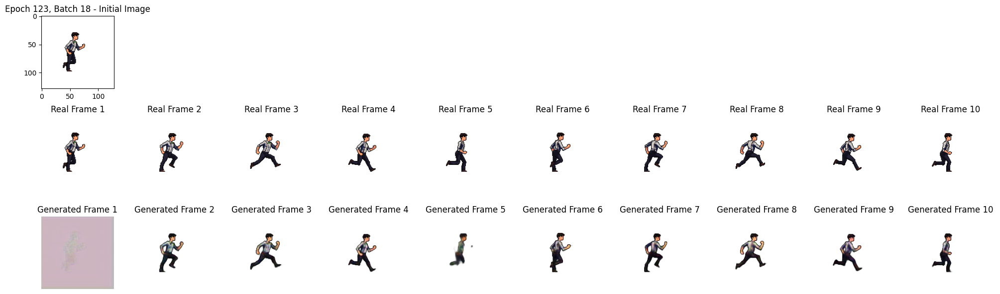

Epoch 125/150


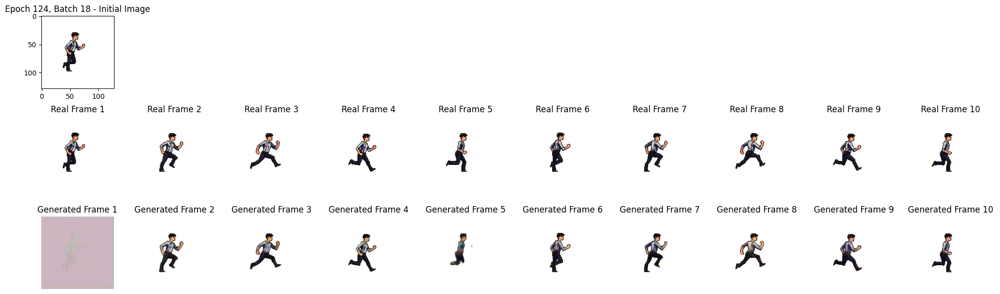

Epoch 126/150


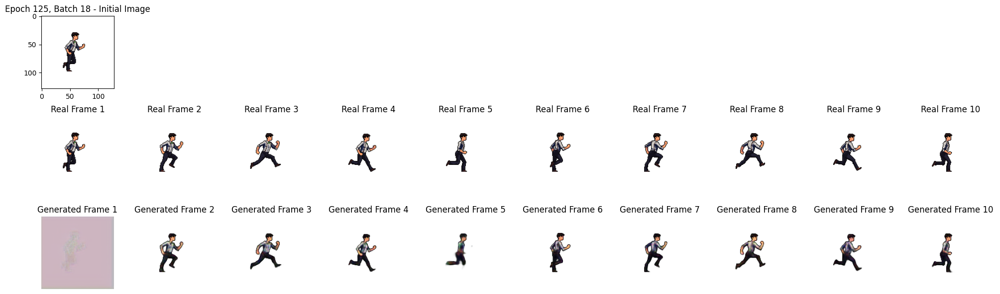

Epoch 127/150


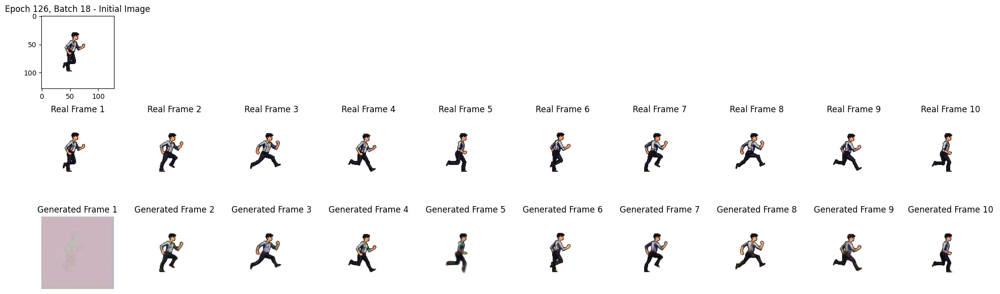

Epoch 128/150


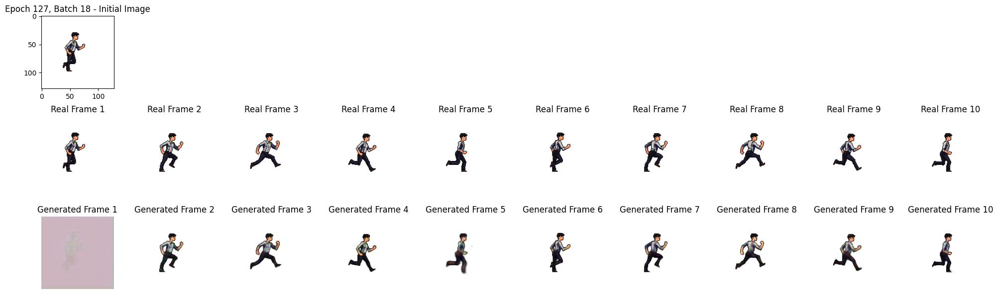

Epoch 129/150


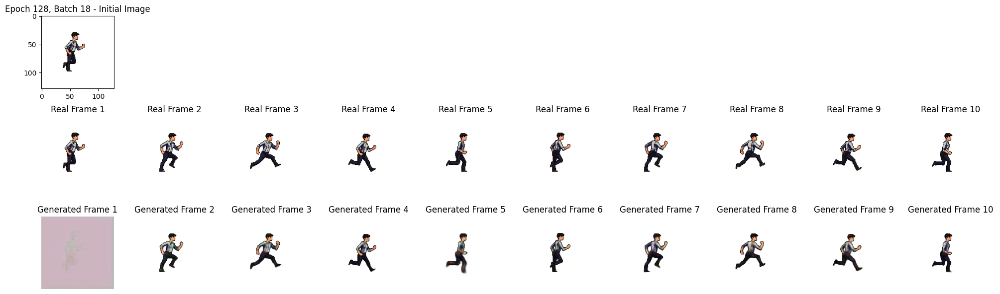

Epoch 130/150


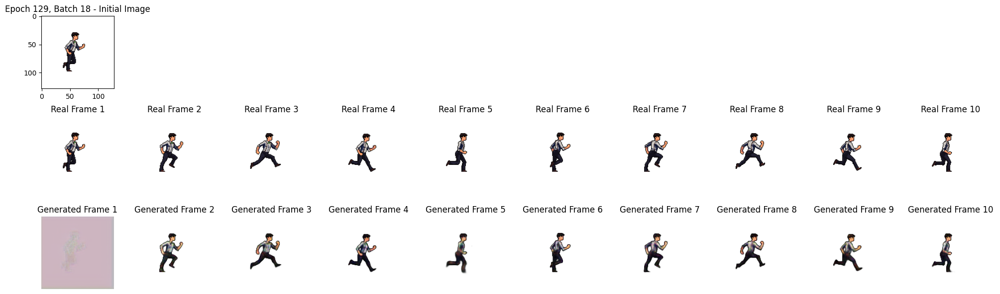

Epoch 131/150


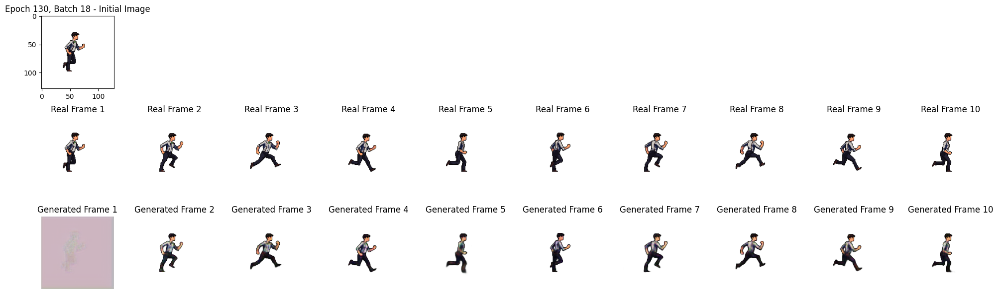

Epoch 132/150


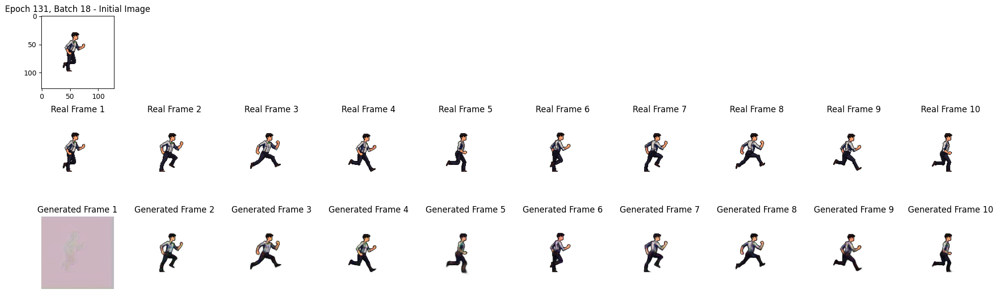

Epoch 133/150


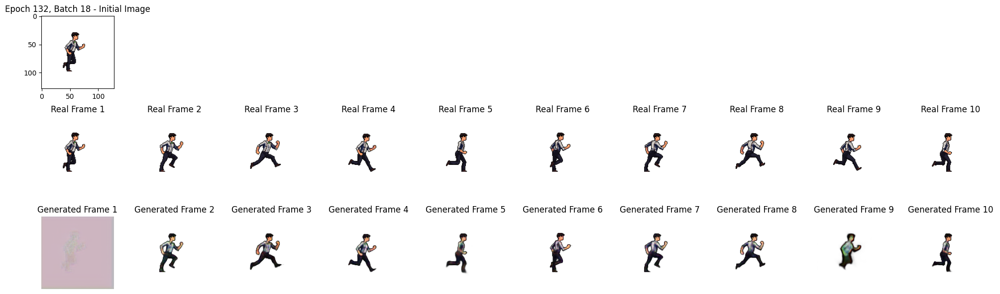

Epoch 134/150


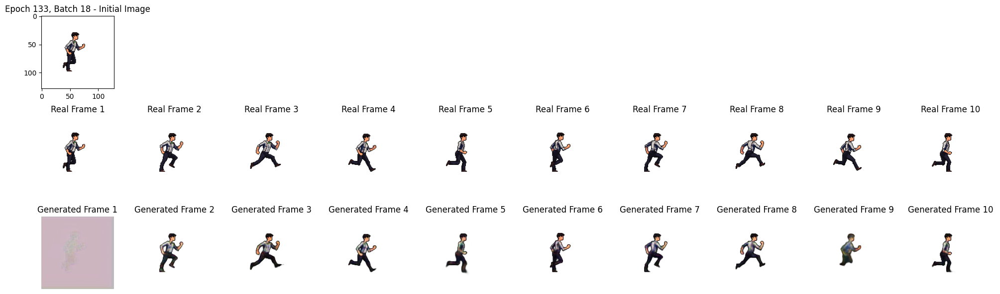

Epoch 135/150


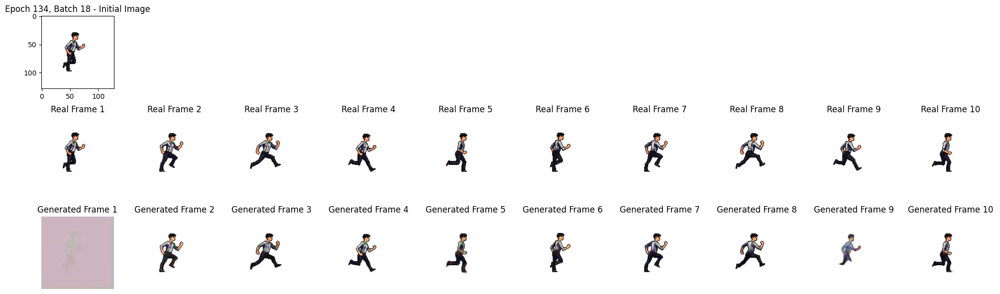

Epoch 136/150


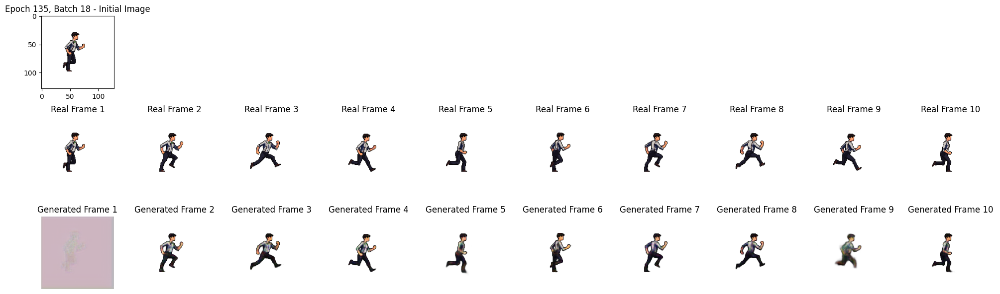

Epoch 137/150


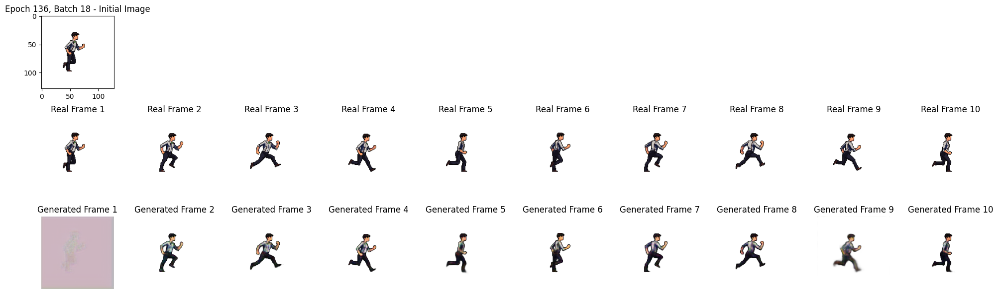

Epoch 138/150


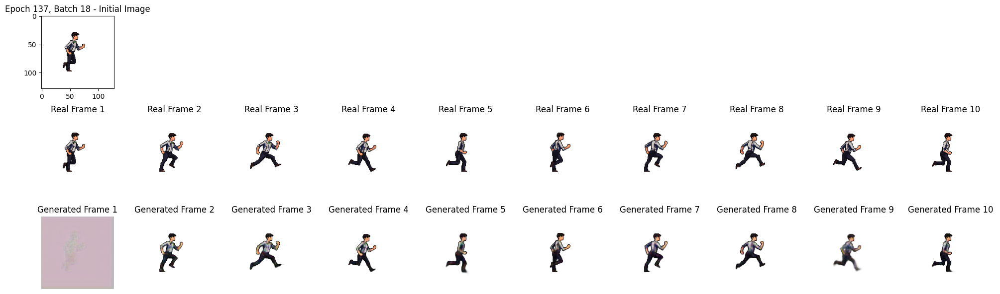

Epoch 139/150


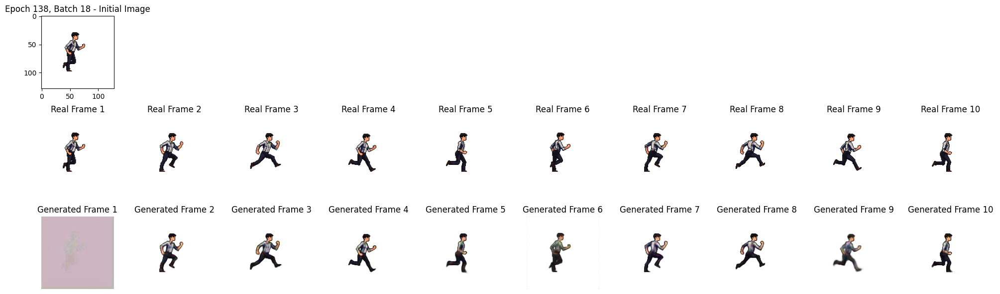

Epoch 140/150


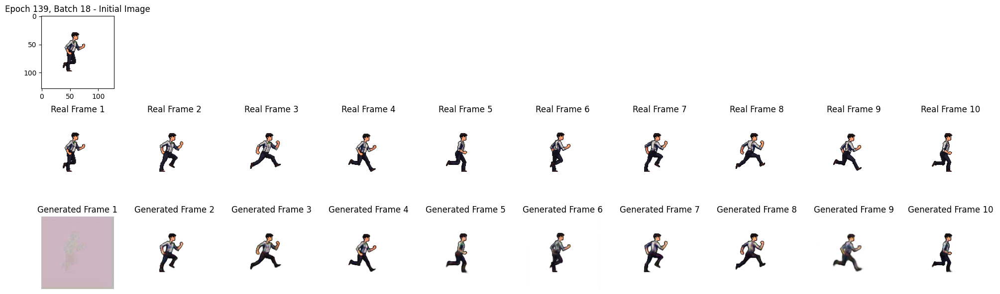

Epoch 141/150


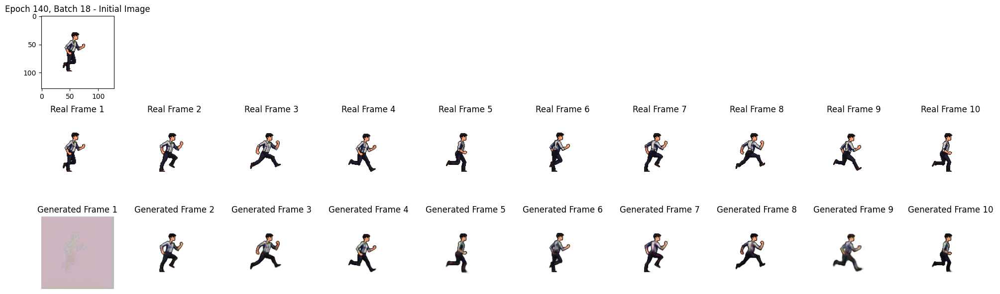

Epoch 142/150


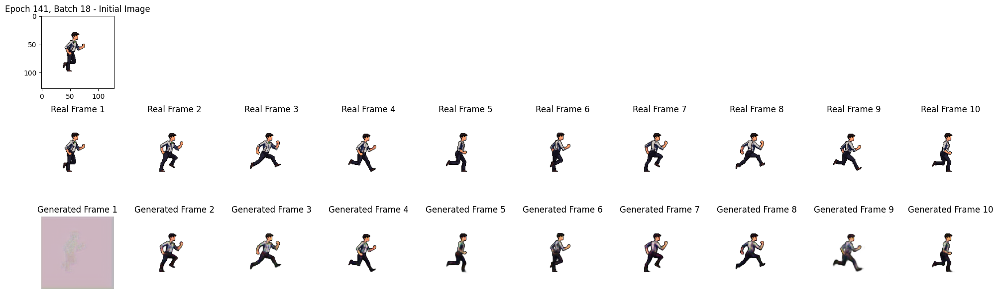

Epoch 143/150


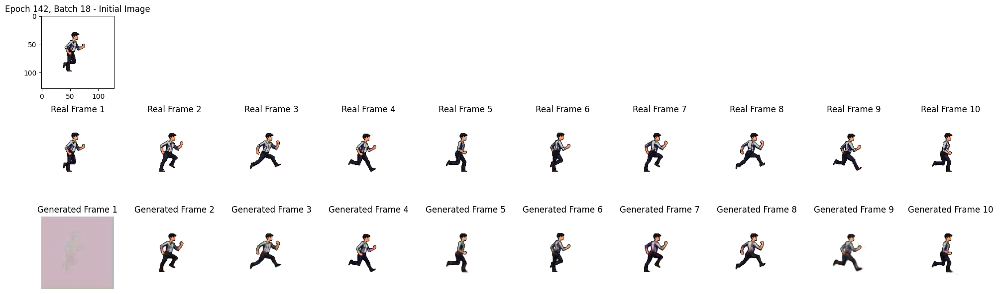

Epoch 144/150


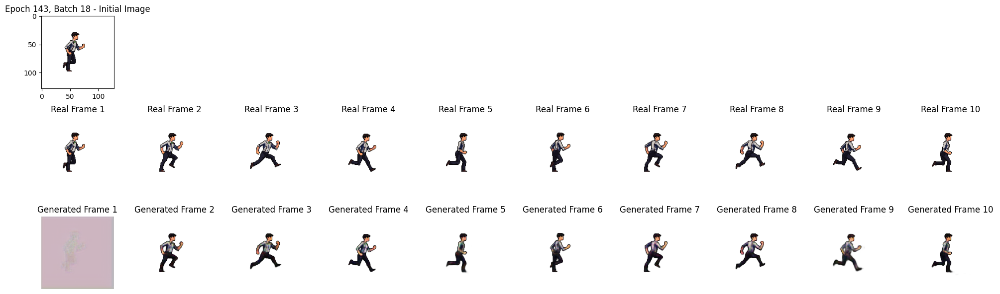

Epoch 145/150


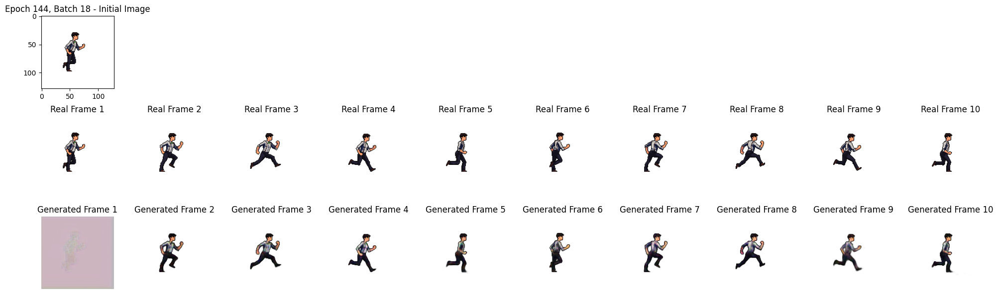

Epoch 146/150


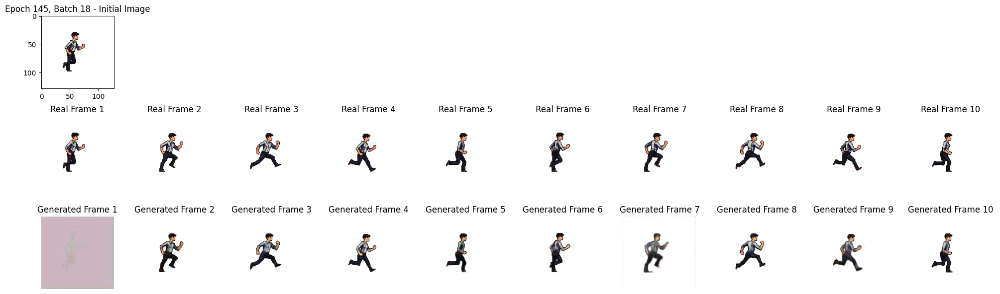

Epoch 147/150


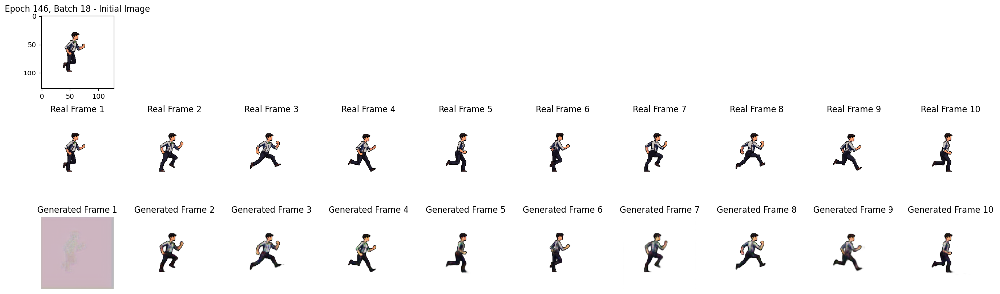

Epoch 148/150


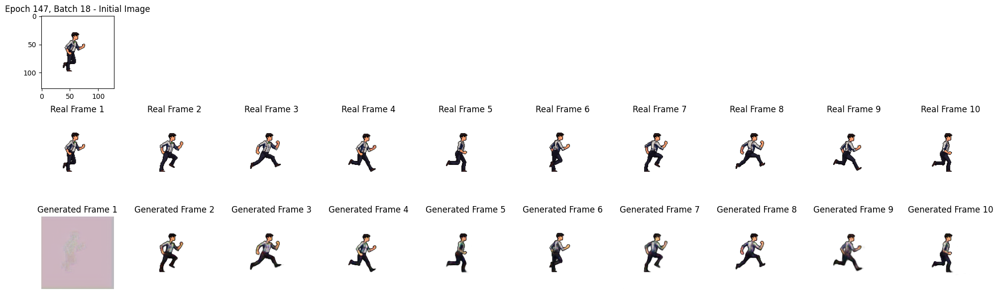

Epoch 149/150


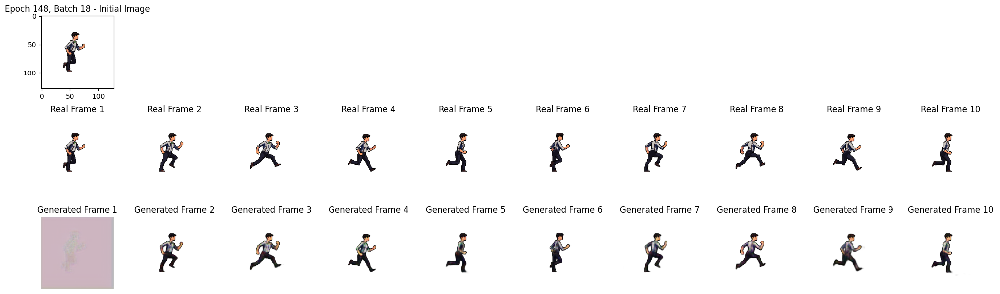

Epoch 150/150


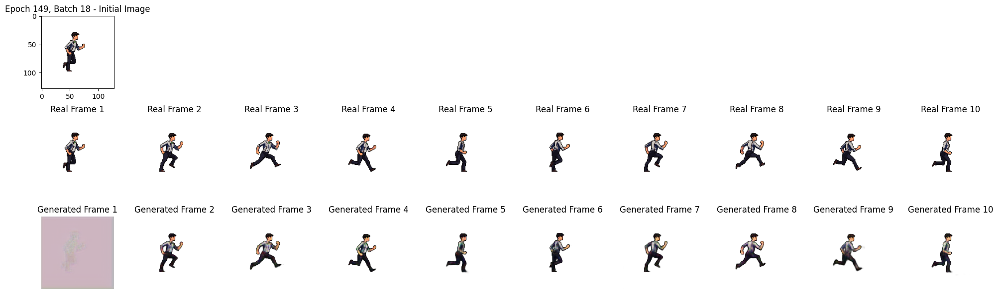

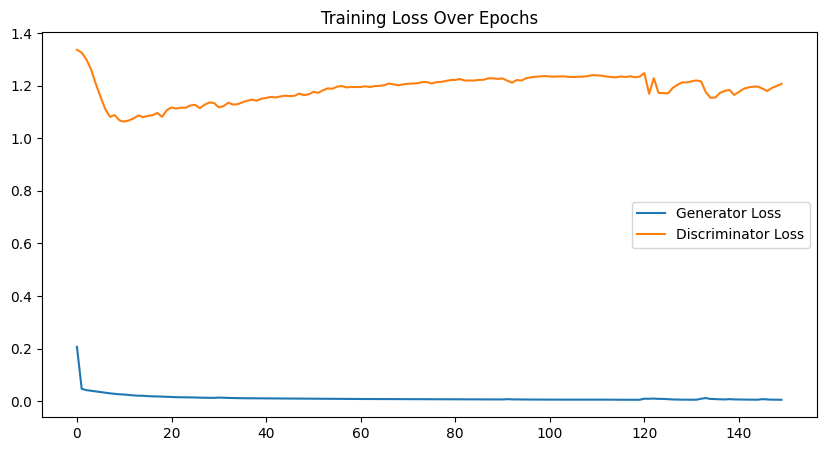

In [57]:
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

if tf.config.list_physical_devices('GPU'):
    with tf.device('/GPU:0'):
        # 모델 초기화
        sequence_length = 10
        generators = [Ayo_Generator(sequence_length=1) for _ in range(sequence_length)]
        discriminators = [Ayo_Discriminator() for _ in range(sequence_length)]
        
        # 학습 함수 호출
        train_gan_per_frame(generators, discriminators, combined_dataset, epochs=150, target_frames=sequence_length, batch_size=16)
else:
    print('NO GPU')

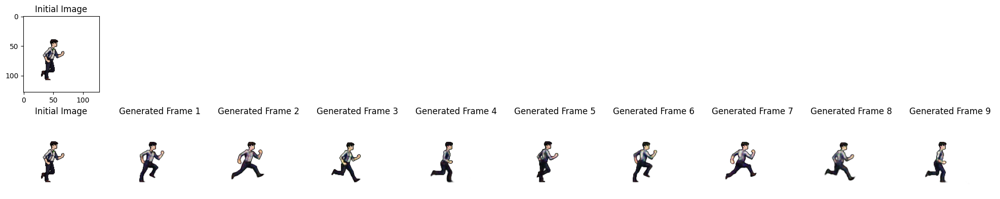

In [58]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

def generate_and_display_frames(generators, initial_image, sequence_length=10):
    """
    학습된 Generator 모델을 사용하여 초기 이미지로부터 프레임 시퀀스를 생성하고 표시합니다.
    
    Args:
        - generators : 각 Frame에 대한 학습된 Generator 모델 리스트
        - initial_image : 첫 번째 입력으로 사용될 초기 이미지 (batch, height, width, channels)
        - sequence_length : 생성할 프레임 수 (기본값은 10)
    """
    generated_frames = []
    current_frame = initial_image

    for frame_index in range(sequence_length):
        # 현재 frame_index에 해당하는 Generator 사용
        generator = generators[frame_index]
        
        # 프레임 생성
        generated_frame = generator(current_frame, tf.constant([frame_index]))  # frame_index 전달
        generated_frames.append(generated_frame)

        # 다음 프레임 생성을 위해 이전에 생성된 프레임을 현재 프레임으로 설정
        # current_frame = generated_frame

    # 이미지 값을 [0, 255]로 스케일링하여 시각화에 적합하게 변환
    generated_frames = [(frame.numpy() + 1) * 127.5 for frame in generated_frames]
    generated_frames = [np.uint8(np.clip(frame[0], 0, 255)) for frame in generated_frames]

    # 초기 이미지 스케일 조정
    initial_image_display = (initial_image[0].numpy() + 1) * 127.5
    initial_image_display = np.uint8(np.clip(initial_image_display, 0, 255))

    # 생성된 프레임 시퀀스 표시
    fig, axes = plt.subplots(2, sequence_length, figsize=(sequence_length * 2, 4))

    # 첫 번째 행: 초기 이미지 반복 출력
    for i in range(sequence_length):
        if i == 0:
            axes[0, i].imshow(initial_image_display)
            axes[0, i].set_title("Initial Image")
        else:
            axes[0, i].axis("off")  # 나머지 칸은 비워둠

    # 두 번째 행: 생성된 프레임
    for i, frame in enumerate(generated_frames):
        if i == 0:
            axes[1, i].imshow(initial_image_display)
            axes[1, i].set_title("Initial Image")
        else:
            axes[1, i].imshow(frame)
            axes[1, i].set_title(f"Generated Frame {i}")
        axes[1, i].axis("off")
        
    plt.tight_layout()
    plt.show()

# 초기 이미지 로드 및 전처리
test_initial_image = tf.expand_dims(combined_dataset[185, 0], axis=0)  # 첫 번째 이미지 선택
# print(test_initial_image.shape)
test_initial_image = tf.cast(test_initial_image, tf.float32) / 127.5 - 1  # [0, 1] -> [-1, 1] 스케일링

# 생성 함수 호출
generate_and_display_frames(generators, test_initial_image, sequence_length=10)

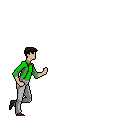

In [85]:
import tensorflow as tf
import numpy as np
import imageio
import io
from PIL import Image as PILImage
from IPython.display import Image, display

def generate_and_display_white_bg_gif(generators, initial_image, sequence_length=10, fps=5, frame_size=(512, 512)):
    """
    학습된 Generator 모델을 사용하여 초기 이미지로부터 프레임 시퀀스를 생성하고 흰색 배경의 GIF로 표시합니다.
    
    Args:
        - generators : 각 Frame에 대한 학습된 Generator 모델 리스트
        - initial_image : 첫 번째 입력으로 사용될 초기 이미지 (batch, height, width, channels)
        - sequence_length : 생성할 프레임 수 (기본값은 10)
        - fps : GIF의 초당 프레임 수 (기본값은 5)
        - frame_size : GIF 프레임의 크기 (기본값은 (512, 512))
    """
    generated_frames = []
    current_frame = initial_image

    for frame_index in range(sequence_length):
        # 현재 frame_index에 해당하는 Generator 사용
        generator = generators[frame_index]
        
        # 프레임 생성
        generated_frame = generator(current_frame, tf.constant([frame_index]))  # frame_index 전달
        generated_frames.append(generated_frame)

    # 이미지 값을 [0, 255]로 스케일링하고, RGBA 형식을 RGB로 변환하여 흰색 배경 추가
    def rgba_to_rgb_with_white_bg(frame):
        rgba_frame = (frame[0].numpy() + 1) * 127.5  # [-1, 1] 범위에서 [0, 255]로 변환
        rgba_frame = np.uint8(np.clip(rgba_frame, 0, 255))
        pil_rgba = PILImage.fromarray(rgba_frame, mode='RGBA')
        
        # 흰색 배경 이미지 생성
        white_bg = PILImage.new("RGB", pil_rgba.size, (255, 255, 255))
        white_bg.paste(pil_rgba, mask=pil_rgba.split()[3])  # A 채널을 마스크로 사용하여 투명도 처리
        return white_bg

    # RGBA를 흰색 배경의 RGB 이미지로 변환
    generated_frames_rgb = [rgba_to_rgb_with_white_bg(frame) for frame in generated_frames]

    # 초기 이미지도 RGB 형식으로 스케일 조정
    initial_image_display = rgba_to_rgb_with_white_bg(initial_image)

    # 첫 번째 프레임을 초기 이미지로 설정하여 GIF 프레임 리스트 생성
    gif_frames = [initial_image_display] + generated_frames_rgb[1:]

    # 메모리 내에서 GIF 생성 (반복 재생)
    gif_bytes = io.BytesIO()
    gif_frames[0].save(gif_bytes, format="GIF", save_all=True, append_images=gif_frames[1:], duration=1000//fps, loop=0)
    gif_bytes.seek(0)  # 파일의 처음 위치로 이동

    # GIF 표시
    display(Image(data=gif_bytes.read(), format="gif"))

# 초기 이미지 로드 및 전처리
test_initial_image = tf.expand_dims(combined_dataset[290, 0], axis=0)
test_initial_image = tf.cast(test_initial_image, tf.float32) / 127.5 - 1

# 생성 및 GIF 표시 함수 호출
generate_and_display_white_bg_gif(generators, test_initial_image, sequence_length=10, fps=5, frame_size=(512, 512))


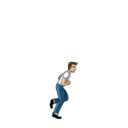

In [81]:
from PIL import Image as PILImage

test_path = 'sam.png'
# test_path = 'gm_sam.png'
# test_path = 'bj_pix.png'
# test_path = 'bj.png'

# PNG 이미지 불러오기 및 전처리
test_initial_image = PILImage.open(test_path).convert("RGBA")
test_initial_image = test_initial_image.resize((128, 128))  # Generator 입력 크기에 맞게 조정
test_initial_image = np.array(test_initial_image) / 127.5 - 1  # [-1, 1]로 스케일링
test_initial_image = tf.expand_dims(test_initial_image, axis=0)  # 배치 차원 추가

# 생성 및 GIF 표시 함수 호출
generate_and_display_white_bg_gif(generators, test_initial_image, sequence_length=10, fps=5, frame_size=(512, 512))

In [86]:
generators[0].summary()

Model: "ayo__generator_411"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4660 (Conv2D)        multiple                  2368      
                                                                 
 conv2d_4661 (Conv2D)        multiple                  73856     
                                                                 
 conv2d_4662 (Conv2D)        multiple                  295168    
                                                                 
 conv2d_4663 (Conv2D)        multiple                  1180160   
                                                                 
 dense_1640 (Dense)          multiple                  4194432   
                                                                 
 embedding_410 (Embedding)   multiple                  1280      
                                                                 
 dense_1641 (Dense)          multiple           